# DonorsChoose

<p>
DonorsChoose.org receives hundreds of thousands of project proposals each year for classroom projects in need of funding. Right now, a large number of volunteers is needed to manually screen each submission before it's approved to be posted on the DonorsChoose.org website.
</p>
<p>
    Next year, DonorsChoose.org expects to receive close to 500,000 project proposals. As a result, there are three main problems they need to solve:
<ul>
<li>
    How to scale current manual processes and resources to screen 500,000 projects so that they can be posted as quickly and as efficiently as possible</li>
    <li>How to increase the consistency of project vetting across different volunteers to improve the experience for teachers</li>
    <li>How to focus volunteer time on the applications that need the most assistance</li>
    </ul>
</p>    
<p>
The goal of the competition is to predict whether or not a DonorsChoose.org project proposal submitted by a teacher will be approved, using the text of project descriptions as well as additional metadata about the project, teacher, and school. DonorsChoose.org can then use this information to identify projects most likely to need further review before approval.
</p>

## About the DonorsChoose Data Set

The `train.csv` data set provided by DonorsChoose contains the following features:

Feature | Description 
----------|---------------
**`project_id`** | A unique identifier for the proposed project. **Example:** `p036502`   
**`project_title`**    | Title of the project. **Examples:**<br><ul><li><code>Art Will Make You Happy!</code></li><li><code>First Grade Fun</code></li></ul> 
**`project_grade_category`** | Grade level of students for which the project is targeted. One of the following enumerated values: <br/><ul><li><code>Grades PreK-2</code></li><li><code>Grades 3-5</code></li><li><code>Grades 6-8</code></li><li><code>Grades 9-12</code></li></ul>  
 **`project_subject_categories`** | One or more (comma-separated) subject categories for the project from the following enumerated list of values:  <br/><ul><li><code>Applied Learning</code></li><li><code>Care &amp; Hunger</code></li><li><code>Health &amp; Sports</code></li><li><code>History &amp; Civics</code></li><li><code>Literacy &amp; Language</code></li><li><code>Math &amp; Science</code></li><li><code>Music &amp; The Arts</code></li><li><code>Special Needs</code></li><li><code>Warmth</code></li></ul><br/> **Examples:** <br/><ul><li><code>Music &amp; The Arts</code></li><li><code>Literacy &amp; Language, Math &amp; Science</code></li>  
  **`school_state`** | State where school is located ([Two-letter U.S. postal code](https://en.wikipedia.org/wiki/List_of_U.S._state_abbreviations#Postal_codes)). **Example:** `WY`
**`project_subject_subcategories`** | One or more (comma-separated) subject subcategories for the project. **Examples:** <br/><ul><li><code>Literacy</code></li><li><code>Literature &amp; Writing, Social Sciences</code></li></ul> 
**`project_resource_summary`** | An explanation of the resources needed for the project. **Example:** <br/><ul><li><code>My students need hands on literacy materials to manage sensory needs!</code</li></ul> 
**`project_essay_1`**    | First application essay<sup>*</sup>  
**`project_essay_2`**    | Second application essay<sup>*</sup> 
**`project_essay_3`**    | Third application essay<sup>*</sup> 
**`project_essay_4`**    | Fourth application essay<sup>*</sup> 
**`project_submitted_datetime`** | Datetime when project application was submitted. **Example:** `2016-04-28 12:43:56.245`   
**`teacher_id`** | A unique identifier for the teacher of the proposed project. **Example:** `bdf8baa8fedef6bfeec7ae4ff1c15c56`  
**`teacher_prefix`** | Teacher's title. One of the following enumerated values: <br/><ul><li><code>nan</code></li><li><code>Dr.</code></li><li><code>Mr.</code></li><li><code>Mrs.</code></li><li><code>Ms.</code></li><li><code>Teacher.</code></li></ul>  
**`teacher_number_of_previously_posted_projects`** | Number of project applications previously submitted by the same teacher. **Example:** `2` 

<sup>*</sup> See the section <b>Notes on the Essay Data</b> for more details about these features.

Additionally, the `resources.csv` data set provides more data about the resources required for each project. Each line in this file represents a resource required by a project:

Feature | Description 
----------|---------------
**`id`** | A `project_id` value from the `train.csv` file.  **Example:** `p036502`   
**`description`** | Desciption of the resource. **Example:** `Tenor Saxophone Reeds, Box of 25`   
**`quantity`** | Quantity of the resource required. **Example:** `3`   
**`price`** | Price of the resource required. **Example:** `9.95`   

**Note:** Many projects require multiple resources. The `id` value corresponds to a `project_id` in train.csv, so you use it as a key to retrieve all resources needed for a project:

The data set contains the following label (the value you will attempt to predict):

Label | Description
----------|---------------
`project_is_approved` | A binary flag indicating whether DonorsChoose approved the project. A value of `0` indicates the project was not approved, and a value of `1` indicates the project was approved.

### Notes on the Essay Data

<ul>
Prior to May 17, 2016, the prompts for the essays were as follows:
<li>__project_essay_1:__ "Introduce us to your classroom"</li>
<li>__project_essay_2:__ "Tell us more about your students"</li>
<li>__project_essay_3:__ "Describe how your students will use the materials you're requesting"</li>
<li>__project_essay_3:__ "Close by sharing why your project will make a difference"</li>
</ul>


<ul>
Starting on May 17, 2016, the number of essays was reduced from 4 to 2, and the prompts for the first 2 essays were changed to the following:<br>
<li>__project_essay_1:__ "Describe your students: What makes your students special? Specific details about their background, your neighborhood, and your school are all helpful."</li>
<li>__project_essay_2:__ "About your project: How will these materials make a difference in your students' learning and improve their school lives?"</li>
<br>For all projects with project_submitted_datetime of 2016-05-17 and later, the values of project_essay_3 and project_essay_4 will be NaN.
</ul>


In [1]:
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import sqlite3
import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer

import re
# Tutorial about Python regular expressions: https://pymotw.com/2/re/
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer

from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

from tqdm import tqdm
import os

from plotly import plotly
import plotly.offline as offline
import plotly.graph_objs as go
offline.init_notebook_mode()
from collections import Counter

## 1.1 Reading Data

In [2]:
project_data = pd.read_csv('train_data.csv')
resource_data = pd.read_csv('resources.csv')

In [3]:
print("Number of data points in train data", project_data.shape)
print('-'*50)
print("The attributes of data :", project_data.columns.values)

Number of data points in train data (109248, 17)
--------------------------------------------------
The attributes of data : ['Unnamed: 0' 'id' 'teacher_id' 'teacher_prefix' 'school_state'
 'project_submitted_datetime' 'project_grade_category'
 'project_subject_categories' 'project_subject_subcategories'
 'project_title' 'project_essay_1' 'project_essay_2' 'project_essay_3'
 'project_essay_4' 'project_resource_summary'
 'teacher_number_of_previously_posted_projects' 'project_is_approved']


In [4]:
# how to replace elements in list python: https://stackoverflow.com/a/2582163/4084039
cols = ['Date' if x=='project_submitted_datetime' else x for x in list(project_data.columns)]


#sort dataframe based on time pandas python: https://stackoverflow.com/a/49702492/4084039
project_data['Date'] = pd.to_datetime(project_data['project_submitted_datetime'])
project_data.drop('project_submitted_datetime', axis=1, inplace=True)
project_data.sort_values(by=['Date'], inplace=True)


# how to reorder columns pandas python: https://stackoverflow.com/a/13148611/4084039
project_data = project_data[cols]


project_data.head(2)

,Unnamed: 0,id,teacher_id,teacher_prefix,school_state,Date,project_grade_category,project_subject_categories,project_subject_subcategories,project_title,project_essay_1,project_essay_2,project_essay_3,project_essay_4,project_resource_summary,teacher_number_of_previously_posted_projects,project_is_approved
55660,8393,p205479,2bf07ba08945e5d8b2a3f269b2b3cfe5,Mrs.,CA,2016-04-27 00:27:36,Grades PreK-2,Math & Science,"Applied Sciences, Health & Life Science",Engineering STEAM into the Primary Classroom,I have been fortunate enough to use the Fairy ...,My students come from a variety of backgrounds...,Each month I try to do several science or STEM...,It is challenging to develop high quality scie...,My students need STEM kits to learn critical s...,53,1
76127,37728,p043609,3f60494c61921b3b43ab61bdde2904df,Ms.,UT,2016-04-27 00:31:25,Grades 3-5,Special Needs,Special Needs,Sensory Tools for Focus,Imagine being 8-9 years old. You're in your th...,"Most of my students have autism, anxiety, anot...",It is tough to do more than one thing at a tim...,When my students are able to calm themselves d...,My students need Boogie Boards for quiet senso...,4,1


In [5]:
print("Number of data points in train data", resource_data.shape)
print(resource_data.columns.values)
resource_data.head(2)

Number of data points in train data (1541272, 4)
['id' 'description' 'quantity' 'price']


,id,description,quantity,price
0,p233245,LC652 - Lakeshore Double-Space Mobile Drying Rack,1,149.00
1,p069063,Bouncy Bands for Desks (Blue support pipes),3,14.95


## 1.2 preprocessing of `project_subject_categories`

In [6]:
catogories = list(project_data['project_subject_categories'].values)
# remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039

# https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
# https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
# https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python
cat_list = []
for i in catogories:
    temp = ""
    # consider we have text like this "Math & Science, Warmth, Care & Hunger"
    for j in i.split(','): # it will split it in three parts ["Math & Science", "Warmth", "Care & Hunger"]
        if 'The' in j.split(): # this will split each of the catogory based on space "Math & Science"=> "Math","&", "Science"
            j=j.replace('The','') # if we have the words "The" we are going to replace it with ''(i.e removing 'The')
        j = j.replace(' ','') # we are placeing all the ' '(space) with ''(empty) ex:"Math & Science"=>"Math&Science"
        temp+=j.strip()+" " #" abc ".strip() will return "abc", remove the trailing spaces
        temp = temp.replace('&','_') # we are replacing the & value into 
    cat_list.append(temp.strip())
    
project_data['clean_categories'] = cat_list
project_data.drop(['project_subject_categories'], axis=1, inplace=True)

from collections import Counter
my_counter = Counter()
for word in project_data['clean_categories'].values:
    my_counter.update(word.split())

cat_dict = dict(my_counter)
sorted_cat_dict = dict(sorted(cat_dict.items(), key=lambda kv: kv[1]))


## 1.3 preprocessing of `project_subject_subcategories`

In [7]:
sub_catogories = list(project_data['project_subject_subcategories'].values)
# remove special characters from list of strings python: https://stackoverflow.com/a/47301924/4084039

# https://www.geeksforgeeks.org/removing-stop-words-nltk-python/
# https://stackoverflow.com/questions/23669024/how-to-strip-a-specific-word-from-a-string
# https://stackoverflow.com/questions/8270092/remove-all-whitespace-in-a-string-in-python

sub_cat_list = []
for i in sub_catogories:
    temp = ""
    # consider we have text like this "Math & Science, Warmth, Care & Hunger"
    for j in i.split(','): # it will split it in three parts ["Math & Science", "Warmth", "Care & Hunger"]
        if 'The' in j.split(): # this will split each of the catogory based on space "Math & Science"=> "Math","&", "Science"
            j=j.replace('The','') # if we have the words "The" we are going to replace it with ''(i.e removing 'The')
        j = j.replace(' ','') # we are placeing all the ' '(space) with ''(empty) ex:"Math & Science"=>"Math&Science"
        temp +=j.strip()+" "#" abc ".strip() will return "abc", remove the trailing spaces
        temp = temp.replace('&','_')
    sub_cat_list.append(temp.strip())

project_data['clean_subcategories'] = sub_cat_list
project_data.drop(['project_subject_subcategories'], axis=1, inplace=True)

# count of all the words in corpus python: https://stackoverflow.com/a/22898595/4084039
my_counter = Counter()
for word in project_data['clean_subcategories'].values:
    my_counter.update(word.split())
    
sub_cat_dict = dict(my_counter)
sorted_sub_cat_dict = dict(sorted(sub_cat_dict.items(), key=lambda kv: kv[1]))

## 1.3 Text preprocessing

In [8]:
# merge two column text dataframe: 
project_data["essay"] = project_data["project_essay_1"].map(str) +\
                        project_data["project_essay_2"].map(str) + \
                        project_data["project_essay_3"].map(str) + \
                        project_data["project_essay_4"].map(str)

In [9]:
project_data.head(2)

,Unnamed: 0,id,teacher_id,teacher_prefix,school_state,Date,project_grade_category,project_title,project_essay_1,project_essay_2,project_essay_3,project_essay_4,project_resource_summary,teacher_number_of_previously_posted_projects,project_is_approved,clean_categories,clean_subcategories,essay
55660,8393,p205479,2bf07ba08945e5d8b2a3f269b2b3cfe5,Mrs.,CA,2016-04-27 00:27:36,Grades PreK-2,Engineering STEAM into the Primary Classroom,I have been fortunate enough to use the Fairy ...,My students come from a variety of backgrounds...,Each month I try to do several science or STEM...,It is challenging to develop high quality scie...,My students need STEM kits to learn critical s...,53,1,Math_Science,AppliedSciences Health_LifeScience,I have been fortunate enough to use the Fairy ...
76127,37728,p043609,3f60494c61921b3b43ab61bdde2904df,Ms.,UT,2016-04-27 00:31:25,Grades 3-5,Sensory Tools for Focus,Imagine being 8-9 years old. You're in your th...,"Most of my students have autism, anxiety, anot...",It is tough to do more than one thing at a tim...,When my students are able to calm themselves d...,My students need Boogie Boards for quiet senso...,4,1,SpecialNeeds,SpecialNeeds,Imagine being 8-9 years old. You're in your th...


In [10]:
#### 1.4.2.3 Using Pretrained Models: TFIDF weighted W2V

In [11]:
# printing some random reviews
print(project_data['essay'].values[0])
print("="*50)
print(project_data['essay'].values[150])
print("="*50)
print(project_data['essay'].values[1000])
print("="*50)
print(project_data['essay'].values[20000])
print("="*50)
print(project_data['essay'].values[99999])
print("="*50)

I have been fortunate enough to use the Fairy Tale STEM kits in my classroom as well as the STEM journals, which my students really enjoyed.  I would love to implement more of the Lakeshore STEM kits in my classroom for the next school year as they provide excellent and engaging STEM lessons.My students come from a variety of backgrounds, including language and socioeconomic status.  Many of them don't have a lot of experience in science and engineering and these kits give me the materials to provide these exciting opportunities for my students.Each month I try to do several science or STEM/STEAM projects.  I would use the kits and robot to help guide my science instruction in engaging and meaningful ways.  I can adapt the kits to my current language arts pacing guide where we already teach some of the material in the kits like tall tales (Paul Bunyan) or Johnny Appleseed.  The following units will be taught in the next school year where I will implement these kits: magnets, motion, si

In [12]:
# https://stackoverflow.com/a/47091490/4084039
import re

def decontracted(phrase):
    # specific
    phrase = re.sub(r"won't", "will not", phrase)
    phrase = re.sub(r"can\'t", "can not", phrase)

    # general
    phrase = re.sub(r"n\'t", " not", phrase)
    phrase = re.sub(r"\'re", " are", phrase)
    phrase = re.sub(r"\'s", " is", phrase)
    phrase = re.sub(r"\'d", " would", phrase)
    phrase = re.sub(r"\'ll", " will", phrase)
    phrase = re.sub(r"\'t", " not", phrase)
    phrase = re.sub(r"\'ve", " have", phrase)
    phrase = re.sub(r"\'m", " am", phrase)
    return phrase

In [13]:
sent = decontracted(project_data['essay'].values[20000])
print(sent)
print("="*50)

\"A person is a person, no matter how small.\" (Dr.Seuss) I teach the smallest students with the biggest enthusiasm for learning. My students learn in many different ways using all of our senses and multiple intelligences. I use a wide range of techniques to help all my students succeed. \r\nStudents in my class come from a variety of different backgrounds which makes for wonderful sharing of experiences and cultures, including Native Americans.\r\nOur school is a caring community of successful learners which can be seen through collaborative student project based learning in and out of the classroom. Kindergarteners in my class love to work with hands-on materials and have many different opportunities to practice a skill before it is mastered. Having the social skills to work cooperatively with friends is a crucial aspect of the kindergarten curriculum.Montana is the perfect place to learn about agriculture and nutrition. My students love to role play in our pretend kitchen in the ear

In [14]:
# \r \n \t remove from string python: http://texthandler.com/info/remove-line-breaks-python/
sent = sent.replace('\\r', ' ')
sent = sent.replace('\\"', ' ')
sent = sent.replace('\\n', ' ')
print(sent)

 A person is a person, no matter how small.  (Dr.Seuss) I teach the smallest students with the biggest enthusiasm for learning. My students learn in many different ways using all of our senses and multiple intelligences. I use a wide range of techniques to help all my students succeed.   Students in my class come from a variety of different backgrounds which makes for wonderful sharing of experiences and cultures, including Native Americans.  Our school is a caring community of successful learners which can be seen through collaborative student project based learning in and out of the classroom. Kindergarteners in my class love to work with hands-on materials and have many different opportunities to practice a skill before it is mastered. Having the social skills to work cooperatively with friends is a crucial aspect of the kindergarten curriculum.Montana is the perfect place to learn about agriculture and nutrition. My students love to role play in our pretend kitchen in the early chi

In [15]:
#remove spacial character: https://stackoverflow.com/a/5843547/4084039
sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
print(sent)

 A person is a person no matter how small Dr Seuss I teach the smallest students with the biggest enthusiasm for learning My students learn in many different ways using all of our senses and multiple intelligences I use a wide range of techniques to help all my students succeed Students in my class come from a variety of different backgrounds which makes for wonderful sharing of experiences and cultures including Native Americans Our school is a caring community of successful learners which can be seen through collaborative student project based learning in and out of the classroom Kindergarteners in my class love to work with hands on materials and have many different opportunities to practice a skill before it is mastered Having the social skills to work cooperatively with friends is a crucial aspect of the kindergarten curriculum Montana is the perfect place to learn about agriculture and nutrition My students love to role play in our pretend kitchen in the early childhood classroom

In [16]:
# https://gist.github.com/sebleier/554280
# we are removing the words from the stop words list: 'no', 'nor', 'not'
stopwords= ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've",\
            "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', \
            'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their',\
            'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', \
            'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', \
            'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', \
            'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after',\
            'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further',\
            'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more',\
            'most', 'other', 'some', 'such', 'only', 'own', 'same', 'so', 'than', 'too', 'very', \
            's', 't', 'can', 'will', 'just', 'don', "don't", 'should', "should've", 'now', 'd', 'll', 'm', 'o', 're', \
            've', 'y', 'ain', 'aren', "aren't", 'couldn', "couldn't", 'didn', "didn't", 'doesn', "doesn't", 'hadn',\
            "hadn't", 'hasn', "hasn't", 'haven', "haven't", 'isn', "isn't", 'ma', 'mightn', "mightn't", 'mustn',\
            "mustn't", 'needn', "needn't", 'shan', "shan't", 'shouldn', "shouldn't", 'wasn', "wasn't", 'weren', "weren't", \
            'won', "won't", 'wouldn', "wouldn't"]

In [17]:
# Combining all the above stundents 
from tqdm import tqdm
preprocessed_essays = []
# tqdm is for printing the status bar
for sentance in tqdm(project_data['essay'].values):
    sent = decontracted(sentance)
    sent = sent.replace('\\r', ' ')
    sent = sent.replace('\\"', ' ')
    sent = sent.replace('\\n', ' ')
    sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
    # https://gist.github.com/sebleier/554280
    sent = ' '.join(e for e in sent.split() if e.lower() not in stopwords)
    preprocessed_essays.append(sent.lower().strip())

100%|████████████████████████████████████████████████████████████████████████| 109248/109248 [01:39<00:00, 1096.89it/s]


In [18]:
preprocessed_essay_count= pd.DataFrame(preprocessed_essays)
project_data['essay_count'] = preprocessed_essay_count[0].str.count(' ')

In [19]:
def preprocessing(x,y):
    from tqdm import tqdm
    import math
    from collections import Counter
    preprocessed_essays = []
    my_count = Counter()
    a=[]
    # tqdm is for printing the status bar
    for sentance in tqdm(x[y].values):
        if sentance!=0:
            sent = decontracted(sentance)
            sent = sent.replace('\\r', ' ')
            sent = sent.replace('\\"', ' ')
            sent = sent.replace('\\n', ' ')
            sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
            # https://gist.github.com/sebleier/554280
            sent = ' '.join(e for e in sent.split() if e.lower() not in stopwords)
            preprocessed_essays.append(sent.lower().strip())
        else:
            preprocessed_essays.append(0)
    return preprocessed_essays

In [20]:
preprocessed_essay1= preprocessing( project_data,"project_essay_1")
preprocessed_essay1= pd.DataFrame(preprocessed_essay1)

100%|████████████████████████████████████████████████████████████████████████| 109248/109248 [00:37<00:00, 2899.44it/s]


In [21]:
preprocessed_essay2= preprocessing( project_data,"project_essay_2")
preprocessed_essay2= pd.DataFrame(preprocessed_essay2)

100%|████████████████████████████████████████████████████████████████████████| 109248/109248 [00:46<00:00, 2374.80it/s]


In [22]:
project_data["project_essay_3"].fillna(0, inplace=True)

preprocessed_essay3= preprocessing( project_data, "project_essay_3")
preprocessed_essay3= pd.DataFrame(preprocessed_essay3)

100%|███████████████████████████████████████████████████████████████████████| 109248/109248 [00:01<00:00, 85272.81it/s]


In [23]:
project_data["project_essay_4"].fillna(0, inplace=True)
preprocessed_essay4= preprocessing( project_data,"project_essay_4")
preprocessed_essay4= pd.DataFrame(preprocessed_essay4)

100%|██████████████████████████████████████████████████████████████████████| 109248/109248 [00:00<00:00, 124863.91it/s]


In [24]:
project_data['essay1'] = preprocessed_essay1[0].str.count(' ')
project_data['essay2'] = preprocessed_essay2[0].str.count(' ')
project_data['essay3'] = preprocessed_essay3[0].str.count(' ')
project_data['essay4'] = preprocessed_essay4[0].str.count(' ')



In [25]:
# after preprocesing
len(preprocessed_essays)

109248

<h2><font color='red'> 1.4 Preprocessing of `project_title`</font></h2>

In [26]:
# similarly you can preprocess the titles also
from tqdm import tqdm
preprocessed_titles = []
# tqdm is for printing the status bar
for sentance in tqdm(project_data['project_title'].values):
    sent = decontracted(sentance)
    sent = sent.replace('\\r', ' ')
    sent = sent.replace('\\"', ' ')
    sent = sent.replace('\\n', ' ')
    sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
    # https://gist.github.com/sebleier/554280
    sent = ' '.join(e for e in sent.split() if e.lower() not in stopwords)
    preprocessed_titles.append(sent.lower().strip())
preprocessed_titles[2]

100%|███████████████████████████████████████████████████████████████████████| 109248/109248 [00:03<00:00, 28657.23it/s]


'mobile learning mobile listening center'

In [27]:
preprocessed_titlec= pd.DataFrame(preprocessed_titles)
project_data['title_count'] = preprocessed_titlec[0].str.count(' ')

### resource summary

In [28]:
from tqdm import tqdm
preprocessed_summary = []
# tqdm is for printing the status bar
for sentance in tqdm(project_data['project_resource_summary'].values):
    sent = decontracted(sentance)
    sent = sent.replace('\\r', ' ')
    sent = sent.replace('\\"', ' ')
    sent = sent.replace('\\n', ' ')
    sent = re.sub('[^A-Za-z0-9]+', ' ', sent)
    # https://gist.github.com/sebleier/554280
    sent = ' '.join(e for e in sent.split() if e.lower() not in stopwords)
    preprocessed_summary.append(sent.lower().strip())
preprocessed_summary[2]

100%|███████████████████████████████████████████████████████████████████████| 109248/109248 [00:08<00:00, 13391.22it/s]


'students need mobile listening center able enhance learning'

## 1.5 Preparing data for models

In [29]:
project_data.columns

Index(['Unnamed: 0', 'id', 'teacher_id', 'teacher_prefix', 'school_state',
       'Date', 'project_grade_category', 'project_title', 'project_essay_1',
       'project_essay_2', 'project_essay_3', 'project_essay_4',
       'project_resource_summary',
       'teacher_number_of_previously_posted_projects', 'project_is_approved',
       'clean_categories', 'clean_subcategories', 'essay', 'essay_count',
       'essay1', 'essay2', 'essay3', 'essay4', 'title_count'],
      dtype='object')

we are going to consider

       - school_state : categorical data
       - clean_categories : categorical data
       - clean_subcategories : categorical data
       - project_grade_category : categorical data
       - teacher_prefix : categorical data
       
       - project_title : text data
       - text : text data
       - project_resource_summary: text data (optinal)
       
       - quantity : numerical (optinal)
       - teacher_number_of_previously_posted_projects : numerical
       - price : numerical

### 1.5.1 Vectorizing Categorical data

- https://www.appliedaicourse.com/course/applied-ai-course-online/lessons/handling-categorical-and-numerical-features/

#### 1.5.2.3 Using Pretrained Models: Avg W2V

In [30]:
# stronging variables into pickle files python: http://www.jessicayung.com/how-to-use-pickle-to-save-and-load-variables-in-python/
# make sure you have the glove_vectors file
with open('glove_vectors', 'rb') as f:
    model = pickle.load(f)
    glove_words =  set(model.keys())

### 1.5.3 Vectorizing Numerical features

In [31]:
price_data = resource_data.groupby('id').agg({'price':'sum', 'quantity':'sum'}).reset_index()
project_data = pd.merge(project_data, price_data, on='id', how='left')

In [32]:
# check this one: https://www.youtube.com/watch?v=0HOqOcln3Z4&t=530s
# standardization sklearn: https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html
from sklearn.preprocessing import StandardScaler

# price_standardized = standardScalar.fit(project_data['price'].values)
# this will rise the error
# ValueError: Expected 2D array, got 1D array instead: array=[725.05 213.03 329.   ... 399.   287.73   5.5 ].
# Reshape your data either using array.reshape(-1, 1)

price_scalar = StandardScaler()
price_scalar.fit(project_data['price'].values.reshape(-1,1)) # finding the mean and standard deviation of this data
print(f"Mean : {price_scalar.mean_[0]}, Standard deviation : {np.sqrt(price_scalar.var_[0])}")

# Now standardize the data with above maen and variance.
price_standardized = price_scalar.transform(project_data['price'].values.reshape(-1, 1))

Mean : 298.1193425966608, Standard deviation : 367.49634838483496


In [33]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# import nltk
# nltk.download('vader_lexicon')

sid = SentimentIntensityAnalyzer()

for_sentiment = 'a person is a person no matter how small dr seuss i teach the smallest students with the biggest enthusiasm \
for learning my students learn in many different ways using all of our senses and multiple intelligences i use a wide range\
of techniques to help all my students succeed students in my class come from a variety of different backgrounds which makes\
for wonderful sharing of experiences and cultures including native americans our school is a caring community of successful \
learners which can be seen through collaborative student project based learning in and out of the classroom kindergarteners \
in my class love to work with hands on materials and have many different opportunities to practice a skill before it is\
mastered having the social skills to work cooperatively with friends is a crucial aspect of the kindergarten curriculum\
montana is the perfect place to learn about agriculture and nutrition my students love to role play in our pretend kitchen\
in the early childhood classroom i have had several kids ask me can we try cooking with real food i will take their idea \
and create common core cooking lessons where we learn important math and writing concepts while cooking delicious healthy \
food for snack time my students will have a grounded appreciation for the work that went into making the food and knowledge \
of where the ingredients came from as well as how it is healthy for their bodies this project would expand our learning of \
nutrition and agricultural cooking recipes by having us peel our own apples to make homemade applesauce make our own bread \
and mix up healthy plants from our classroom garden in the spring we will also create our own cookbooks to be printed and \
shared with families students will gain math and literature skills as well as a life long enjoyment for healthy cooking \
nannan'
negative=[]
neutral=[]
positive=[]
compound=[]
#ss = sid.polarity_scores(for_sentiment)
for i in range(0, len(preprocessed_essays)):
    a=sid.polarity_scores(preprocessed_essays[i])
    negative.append(a["neg"])
    neutral.append(a["neu"])
    positive.append(a["pos"])
    compound.append(a["compound"])

print(len(negative))
print(len(neutral))
print(len(positive))
print(len(compound))
    


#for k in ss:
#    print('{0}: {1}, '.format(k, ss[k]), end='')
#print(ss["neg"])
# we can use these 4 things as features/attributes (neg, neu, pos, compound)
# neg: 0.0, neu: 0.753, pos: 0.247, compound: 0.93

C:\Users\chana\Anaconda3\lib\site-packages\nltk\twitter\__init__.py:20: UserWarning:

The twython library has not been installed. Some functionality from the twitter package will not be available.



109248
109248
109248
109248


<h2>2.1 Splitting data into Train and cross validation(or test): Stratified Sampling</h2>

In [34]:
#prepare a dataframe  
print(project_data.columns)
#print(project_data["Date"].head(10))
#must inlcude categories,subcategories, preprocessed essay,preprocessed title,state,grade and prefix
print("="*70)
important_data= project_data[['teacher_number_of_previously_posted_projects','teacher_prefix', 'school_state','Date', 'project_grade_category','project_is_approved','clean_categories', 'clean_subcategories','price']].copy()
#include preprocessed titles,essays
#important_data = important_data.sort_values(by = "Date")
#print(important_data["Date"].head(10))
important_data["teacher_prefix"].fillna("None", inplace = True)
important_data["processed_essays"]= preprocessed_essays
important_data["processed_titles"]= preprocessed_titles
important_data["processed_summary"]= preprocessed_summary
important_data['title_count']= project_data['title_count']
important_data["essay_count"]= project_data['essay_count']
important_data["essay1"]= project_data['essay1']
important_data["essay2"]= project_data['essay2']
important_data["essay3"]= project_data['essay3']
important_data["essay4"]= project_data['essay4']
important_data["essay3"].fillna(0, inplace=True)
important_data["essay4"].fillna(0, inplace=True)
important_data["negative_score"]= negative 
important_data["neutral_score"]= neutral
important_data["positive_score"]= positive
important_data["compound_score"]= compound
#important_data["new_price"]=
new_price=[]
for i in important_data.price:
    new_price.append(int(i))
important_data["new_price"]= new_price    

print(important_data.columns)
print("="*70)
print("shape of new data is: ",important_data.shape)
#important_data.project_is_approved = important_data.project_is_approved.map({0.0: -1, 1.0: 1})


Index(['Unnamed: 0', 'id', 'teacher_id', 'teacher_prefix', 'school_state',
       'Date', 'project_grade_category', 'project_title', 'project_essay_1',
       'project_essay_2', 'project_essay_3', 'project_essay_4',
       'project_resource_summary',
       'teacher_number_of_previously_posted_projects', 'project_is_approved',
       'clean_categories', 'clean_subcategories', 'essay', 'essay_count',
       'essay1', 'essay2', 'essay3', 'essay4', 'title_count', 'price',
       'quantity'],
      dtype='object')
Index(['teacher_number_of_previously_posted_projects', 'teacher_prefix',
       'school_state', 'Date', 'project_grade_category', 'project_is_approved',
       'clean_categories', 'clean_subcategories', 'price', 'processed_essays',
       'processed_titles', 'processed_summary', 'title_count', 'essay_count',
       'essay1', 'essay2', 'essay3', 'essay4', 'negative_score',
       'neutral_score', 'positive_score', 'compound_score', 'new_price'],
      dtype='object')
shape of new 

In [35]:
#data_approved = important_data[important_data["project_is_approved"] == 1.0].sample(n = 16000)
#data_rejected = important_data[important_data["project_is_approved"] == 0.0].sample(n = 16000)
#final_data = pd.concat([data_approved, data_rejected])
#final_data = final_data.sort_values(by ="Date")
#important_data= final_data


In [36]:
#splitting data into train test and cv
#https://stackoverflow.com/questions/24147278/how-do-i-create-test-and-train-samples-from-one-dataframe-with-pandas
from sklearn.model_selection import train_test_split
train_data1, data_test= train_test_split(important_data, test_size=0.2, random_state=0)#splitting data into train and test
data_train, data_cv= train_test_split(train_data1, test_size= 0.25, random_state=0)
Y_train= data_train["project_is_approved"].values.reshape(-1,1)
Y_test=  data_test["project_is_approved"].values.reshape(-1,1)
Y_cv=  data_cv["project_is_approved"].values.reshape(-1,1)


In [179]:
print("the shape of train data is: ",data_train.shape) 
print("the shape of test data is: ",data_test.shape)
print("the shape of cv data is: ",data_cv.shape)
#data_test["new_price"][1:10]


the shape of train data is:  (65548, 23)
the shape of test data is:  (21850, 23)
the shape of cv data is:  (21850, 23)


### Response code

In [38]:
def frequency_count(x1,y1,z=0):#x1=data(train,test,cv), y1=category
    from collections import Counter
    my_count = Counter()
    #print(data_train["school_state"][data_train.project_is_approved==0.0].values)
    for wor in x1[y1][x1.project_is_approved==0.0].values:
        if z==0:
            my_count.update(wor.split())#counting the frequency of categories for positive and negative classes separately
        if z==1:
            my_count.update(wor.split(","))
    cat_dicti = dict(my_count)
    #print(my_count)
    #encoded_data=[]
    sorted_cat_dicti = dict(sorted(cat_dicti.items(), key=lambda kv: kv[1]))
    #print(sorted_cat_dicti)
    #print("="*50)

    my_count1 = Counter()
    for wor1 in x1[y1][x1.project_is_approved==1.0].values:
        if z==0:
            my_count1.update(wor1.split())
        if z==1:
            my_count1.update(wor1.split(","))
    cat_dicti1 = dict(my_count1)
    #print(my_count)
    sorted_cat_dicti1 = dict(sorted(cat_dicti1.items(), key=lambda kv: kv[1]))
    #print(sorted_cat_dicti1)
    #print("="*50)
    return sorted_cat_dicti,sorted_cat_dicti1

def fit(x,y):#x=sorted_cat_dicti,y=Sorted_cat_dicti1
    response_data=[]
    if len(x)>len(y):#calculating total number of times a category appeared in negative and positive classes together
        x1=x
        x2=y
    else:
        x1=y
        x2=x
    present= False    
    for j in x1:
        if j in x2:
            response_data.append((j,x1[j]+x2[j]))#if a category appeared in both positive and negative class
        if j not in x2:#if a category appeared either only in positive class or negative class
                response_data.append((j,0+x1[j]))
    for k in x2:             
        if k not in x1:
                response_data.append((k,0+x2[k]))
            
    z= dict(response_data)
    #print(z)
    #global x11=x
    #global y11=y 
    return z#response data

def transform(x_data,z_category,z=0):#x=score,y=data(train,test,cv),z=category without ""
    import pandas as pd
    import numpy as np
    from tqdm import tqdm
    encoded_data0=[]
    encoded_data1=[]
    sorted_cat_dicti,sorted_cat_dicti1=frequency_count(x_data,z_category,z=0)
    for i in tqdm(range(0,len(x_data))): #for each category item
        #print(i)
        present= False
        for j in unapproved_list: #checks if item is in train data
            #print(j)
            if list(x_data[z_category])[i]==j:
                if j in sorted_cat_dicti:#checks if item is in negative class
                    #print(str(j),"and",list(x_data[z_category])[i])
                    encoded_data0.append(sorted_cat_dicti[j]/response_data[j])
                    present= True
        if not present: #if item is not found it checks whether it is in postive class
            #print(list(x_data[z_category])[i])
            if list(x_data[z_category])[i] not in approved_list:
                if list(x_data[z_category])[i] not in sorted_cat_dicti1:
                    encoded_data0.append(0.5) 
            else:#if it is found, we append 0
                encoded_data0.append(0)
                
        present= False            
        for j in approved_list:
            if list(x_data[z_category])[i]==j:#checks if item is in train data
                if j in sorted_cat_dicti1:#checks if item is in positive class
                    #print(j,"and",list(x_data[z_category])[i])
                    encoded_data1.append(sorted_cat_dicti1[j]/response_data[j])
                    present= True
        if not present:#if item is not found it checks whether it is in negative class
            #print(list(x_data[z_category])[i])
            if list(x_data[z_category])[i] not in unapproved_list:
                if list(x_data[z_category])[i] not in sorted_cat_dicti:
                    encoded_data1.append(0.05)
            else:#if it is found, we append 0
                encoded_data1.append(0)
    #encoded_data0 = np.array(encoded_data0)
    #encoded_data1 = np.array(encoded_data1)
    #print(encoded_data1)
    #from scipy.sparse import hstack
    

    dataframe= pd.DataFrame({"class_0":encoded_data0, "class_1":encoded_data1}) 
    return dataframe
                
               

    

In [39]:
#testing
#unapproved_list,approved_list= frequency_count(data_train,"clean_subcategories",1)
#response_data= fit(unapproved_list,approved_list)
#x=transform(data_test,"clean_subcategories")
#unapproved_list,approved_list= frequency_count(data_train[0:100],"school_state")
#response_data= fit(unapproved_list,approved_list)
#sub_categories_one_hot=transform(data_train[0:100],"school_state")
#sub_categories_one_hot
#from scipy.sparse import coo_matrix
#unapproved_list,approved_list= frequency_count(data_train[0:100],"school_state")
#response_data= fit(unapproved_list,approved_list)
#sub_categories_one_hot1=transform(data_train[0:100],"school_state")
#a=np.array(sub_categories_one_hot)
#b=np.array(sub_categories_one_hot1)

#from scipy.sparse import hstack
#b.shape
#v= hstack(a,b)


### Response encoding of categorical features

In [40]:
#state encoding
from collections import Counter
unapproved_list,approved_list= frequency_count(data_train,"school_state")
response_data= fit(unapproved_list,approved_list)
categories_state=transform(data_train,"school_state")
categories_state1=transform(data_cv,"school_state")
categories_state2=transform(data_test,"school_state")

#from tqdm import tqdm
#import string
#prefix_encoding
unapproved_list,approved_list= frequency_count(data_train,"teacher_prefix")
response_data= fit(unapproved_list,approved_list)
categories_prefix=transform(data_train,"teacher_prefix")
categories_prefix1=transform(data_cv,"teacher_prefix")
categories_prefix2=transform(data_test,"teacher_prefix")

#project grade category
unapproved_list,approved_list= frequency_count(data_train,"project_grade_category",1)
response_data= fit(unapproved_list,approved_list)
categories_grade=transform(data_train,"project_grade_category")
categories_grade1=transform(data_cv,"project_grade_category",1)
categories_grade2=transform(data_test,"project_grade_category",1)

#categories_encoding
unapproved_list,approved_list= frequency_count(data_train,"clean_categories")
response_data= fit(unapproved_list,approved_list)
categories_one_hot=transform(data_train,"clean_categories")
categories_one_hot1=transform(data_cv,"clean_categories")
categories_one_hot2=transform(data_test,"clean_categories")

#sub_categories_encoding
unapproved_list,approved_list= frequency_count(data_train,"clean_subcategories")
response_data= fit(unapproved_list,approved_list)
sub_categories_one_hot=transform(data_train,"clean_subcategories")
sub_categories_one_hot1=transform(data_cv,"clean_subcategories")
sub_categories_one_hot2=transform(data_test,"clean_subcategories")

100%|████████████████████████████████████████████████████████████████████████████| 21850/21850 [17:37<00:00, 20.67it/s]


In [134]:
import pickle

#categories_state0=categories_state.to_csv("file_name.csv", sep=',')
#categories_state10= categories_state1.to_csv("file_name1.csv", sep=',')
#categories_state20= categories_state2.to_csv("file_name2.csv", sep=',')

#from tqdm import tqdm
#import string
#prefix_encoding
#categories_prefix0= categories_prefix.to_csv("file_name3.csv",sep=',')
#categories_prefix10= categories_prefix1.to_csv("file_name4.csv", sep=',')
#categories_prefix20= categories_prefix2.to_csv("file_name5.csv", sep=',')

#project grade category
#categories_grade0= categories_grade.to_csv("file_name6.csv", sep=',')
#categories_grade10= categories_grade1.to_csv("file_name7.csv", sep=',')
#categories_grade20= categories_grade2.to_csv("file_name8.csv", sep=',')

#categories_encoding
#categories_one_hot0= categories_one_hot.to_csv("file_name9.csv", sep=',')
#categories_one_hot10= categories_one_hot1.to_csv("file_name10.csv", sep=',')
#categories_one_hot20= categories_one_hot2.to_csv("file_name11.csv", sep=',')


#sub_categories_encoding
#sub_categories_one_hot0= sub_categories_one_hot.to_csv("file_name12.csv", sep=',')
#sub_categories_one_hot10= sub_categories_one_hot1.to_csv("file_name13.csv", sep=',')
#sub_categories_one_hot20= sub_categories_one_hot2.to_csv("file_name14.csv", sep=',')

<h2>2.2 Make Data Model Ready: encoding numerical, categorical features, essays and titles</h2>

In [41]:
def pre_model(y,x): #subfunction
    if y==1:
        #project_essay
        #avg_w2v
        avg_w2v_vectors = []; # the avg-w2v for each sentence/review is stored in this list
        for sentence in tqdm(x.processed_essays): # for each review/sentence
            vector = np.zeros(300) # as word vectors are of zero length
            cnt_words =0; # num of words with a valid vector in the sentence/review
            for word in sentence.split(): # for each word in a review/sentence
                if word in glove_words:
                    vector += model[word]
                    cnt_words += 1
            if cnt_words != 0:
                vector /= cnt_words
            avg_w2v_vectors.append(vector)
        avg_w2v_vectors_array= np.array(avg_w2v_vectors)
        A=avg_w2v_vectors_array
        #print("The shape of matrix after one hot encoding(AVG-V2V): ",avg_w2v_vectors_array.shape)
        #print("="*50)

        #project_title
        #avg_w2v
        avg_w2vt = []; # the avg-w2v for each sentence/review is stored in this list
        for sentence in x.processed_titles: # for each review/sentence
            vector = np.zeros(300) # as word vectors are of zero length
            cnt_words =0; # num of words with a valid vector in the sentence/review
            for word in sentence.split(): # for each word in a review/sentence
                if word in glove_words:
                    vector += model[word]
                    cnt_words += 1
            if cnt_words != 0:
                vector /= cnt_words
            avg_w2vt.append(vector)
        avg_w2vt_array= np.array(avg_w2vt)
        B=avg_w2vt_array
        
        #project_summary
        #avg_w2v
        avg_w2vtc = []; # the avg-w2v for each sentence/review is stored in this list
        for sentence in x.processed_summary: # for each review/sentence
            vector = np.zeros(300) # as word vectors are of zero length
            cnt_words =0; # num of words with a valid vector in the sentence/review
            for word in sentence.split(): # for each word in a review/sentence
                if word in glove_words:
                    vector += model[word]
                    cnt_words += 1
            if cnt_words != 0:
                vector /= cnt_words
            avg_w2vtc.append(vector)
        avg_w2vt_arrayc= np.array(avg_w2vtc)
        C=avg_w2vt_arrayc
 
        return A,B,C
    if y==2:
        #project_essay
        #tfidf_w2v
        tfidf_model = TfidfVectorizer()
        tfidf_model.fit(x.processed_essays)
        # we are converting a dictionary with word as a key, and the idf as a value
        dictionary = dict(zip(tfidf_model.get_feature_names(), list(tfidf_model.idf_)))
        tfidf_words = set(tfidf_model.get_feature_names())

        # compute average word2vec for each review.
        tfidf_w2v_vectors = []; # the avg-w2v for each sentence/review is stored in this list
        for sentence in tqdm(x.processed_essays): # for each review/sentence
            vector = np.zeros(300) # as word vectors are of zero length
            tf_idf_weight =0; # num of words with a valid vector in the sentence/review
            for word in sentence.split(): # for each word in a review/sentence
                if (word in glove_words) and (word in tfidf_words):
                    vec = model[word] # getting the vector for each word
                    # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
                    tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
                    vector += (vec * tf_idf) # calculating tfidf weighted w2v
                    tf_idf_weight += tf_idf
            if tf_idf_weight != 0:
                vector /= tf_idf_weight
            tfidf_w2v_vectors.append(vector)
        tfidf_w2v_vectors_array= np.array(tfidf_w2v_vectors)
        #print(len(tfidf_w2v_vectors[1]))
        A= tfidf_w2v_vectors_array 
        #print("The shape of matrix after one hot encoding(TFIDF-W2V): ",tfidf_w2v_vectors_array.shape)

        #project_title
        #tfidf_w2v
        tfidf_models = TfidfVectorizer()
        tfidf_models.fit(x.processed_titles)
        # we are converting a dictionary with word as a key, and the idf as a value
        dictionary = dict(zip(tfidf_models.get_feature_names(), list(tfidf_models.idf_)))
        tfidf_word = set(tfidf_models.get_feature_names())

        # compute average word2vec for each review.
        tfidf_w2vt = []; # the avg-w2v for each sentence/review is stored in this list
        for sentence in x.processed_titles: # for each review/sentence
            vector = np.zeros(300) # as word vectors are of zero length
            tf_idf_weight =0; # num of words with a valid vector in the sentence/review
            for word in sentence.split(): # for each word in a review/sentence
                if (word in glove_words) and (word in tfidf_word):
                    vec = model[word] # getting the vector for each word
                    # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
                    tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
                    vector += (vec * tf_idf) # calculating tfidf weighted w2v
                    tf_idf_weight += tf_idf
            if tf_idf_weight != 0:
                vector /= tf_idf_weight
            tfidf_w2vt.append(vector)
        #print(len(tfidf_w2vt[1]))    
        tfidf_w2vt_array= np.array(tfidf_w2vt)
        B=tfidf_w2vt_array
        
        #summary
        tfidf_w2vtc = []; # the avg-w2v for each sentence/review is stored in this list
        for sentence in x.processed_summary: # for each review/sentence
            vector = np.zeros(300) # as word vectors are of zero length
            tf_idf_weight =0; # num of words with a valid vector in the sentence/review
            for word in sentence.split(): # for each word in a review/sentence
                if (word in glove_words) and (word in tfidf_word):
                    vec = model[word] # getting the vector for each word
                    # here we are multiplying idf value(dictionary[word]) and the tf value((sentence.count(word)/len(sentence.split())))
                    tf_idf = dictionary[word]*(sentence.count(word)/len(sentence.split())) # getting the tfidf value for each word
                    vector += (vec * tf_idf) # calculating tfidf weighted w2v
                    tf_idf_weight += tf_idf
            if tf_idf_weight != 0:
                vector /= tf_idf_weight
            tfidf_w2vtc.append(vector)
        #print(len(tfidf_w2vt[1]))    
        tfidf_w2vt_arrayc= np.array(tfidf_w2vtc)
        C=tfidf_w2vt_array
        
        return A,B,C  

In [42]:
def data_modelling(y,x,z,u):#function for vectorizing numerical,categorical data along with essays and titles
    %matplotlib inline
    import warnings
    warnings.filterwarnings("ignore")

    import sqlite3
    import pandas as pd
    import numpy as np
    import nltk
    import string
    import matplotlib.pyplot as plt
    import seaborn as sns
    from sklearn.feature_extraction.text import TfidfTransformer
    from sklearn.feature_extraction.text import TfidfVectorizer

    from sklearn.feature_extraction.text import CountVectorizer
    from sklearn.metrics import confusion_matrix
    from sklearn import metrics
    from sklearn.metrics import roc_curve, auc
    from nltk.stem.porter import PorterStemmer

    import re
    # Tutorial about Python regular expressions: https://pymotw.com/2/re/
    import string
    from nltk.corpus import stopwords
    from nltk.stem import PorterStemmer
    from nltk.stem.wordnet import WordNetLemmatizer

    from gensim.models import Word2Vec
    from gensim.models import KeyedVectors
    import pickle

    from tqdm import tqdm
    import os

    from plotly import plotly
    import plotly.offline as offline
    import plotly.graph_objs as go
    offline.init_notebook_mode()
    from collections import Counter
    
    #state encoding
    #from collections import Counter
    #unapproved_list,approved_list= frequency_count(x,"school_state")
    #response_data= fit(unapproved_list,approved_list)
    #categories_state=transform(x,"school_state")
    #categories_state1=transform(z,"school_state")
    #categories_state2=transform(u,"school_state")

    #my_count = Counter()
    #for wor in x['school_state'].values:
    #    my_count.update(wor.split())
    #cat_dicti = dict(my_count)
    #print(my_count)
    #sorted_cat_dicti = dict(sorted(cat_dicti.items(), key=lambda kv: kv[1]))

    #vectorize = CountVectorizer(vocabulary=list(sorted_cat_dicti.keys()), lowercase=False, binary=True)
    #vectorize.fit(x['school_state'].values)
    #a1= vectorize.get_feature_names()

    #categories_state = vectorize.transform(x['school_state'].values)
    #categories_state1 = vectorize.transform(z['school_state'].values)
    #categories_state2 = vectorize.transform(u['school_state'].values)
    #print("Shape of matrix after one hot encodig ",categories_state.shape)
    #print("="*50)
    ##############

    #teacher_prefix encoding
    #from tqdm import tqdm
    #import string
    #unapproved_list,approved_list= frequency_count(x,"teacher_prefix")
    #response_data= fit(unapproved_list,approved_list)
    #categories_prefix=transform(x,"teacher_prefix")
    #categories_prefix1=transform(z,"teacher_prefix")
    #categories_prefix2=transform(u,"teacher_prefix")

    #https://www.geeksforgeeks.org/python-pandas-dataframe-fillna-to-replace-null-values-in-dataframe/
    #my_coun = Counter()
    #for wo in x.teacher_prefix.values:
    #    my_coun.update(wo.split())
    #cat_dictio = dict(my_coun)
    #sorted_cat_dictio = dict(sorted(cat_dictio.items(), key=lambda kv: kv[1]))

    #vectoriz = CountVectorizer(vocabulary=list(sorted_cat_dictio.keys()), lowercase=False, binary=True)
    #vectoriz.fit(x['teacher_prefix'].values)
    #a2= vectoriz.get_feature_names()#print(vectoriz.get_feature_names())
    #categories_prefix = vectoriz.transform(x['teacher_prefix'].values)
    #categories_prefix1 = vectoriz.transform(z['teacher_prefix'].values)
    #categories_prefix2 = vectoriz.transform(u['teacher_prefix'].values)
    #print("Shape of matrix after one hot encoding ",categories_prefix.shape)
    #print("="*50)


    #project grade category
    #unapproved_list,approved_list= frequency_count(x,"project_grade_category",1)
    #response_data= fit(unapproved_list,approved_list)
    #categories_grade=transform(x,"project_grade_category")
    #categories_grade1=transform(z,"project_grade_category")
    #categories_grade2=transform(u,"project_grade_category")

    #my_count = Counter()
    #for w in x['project_grade_category'].values:
    #    my_count.update(w.split(","))
    #cat_dic = dict(my_count)
    #sorted_cat_dic = dict(sorted(cat_dic.items(), key=lambda kv: kv[1]))

    #vector = CountVectorizer(vocabulary=list(sorted_cat_dic.keys()), lowercase=False, binary=True)
    #vector.fit(x['project_grade_category'].values)
    #a3= vector.get_feature_names()
    #categories_grade= vector.transform(x['project_grade_category'].values)
    #categories_grade1= vector.transform(z['project_grade_category'].values)
    #categories_grade2= vector.transform(u['project_grade_category'].values)
    #print("Shape of matrix after one hot encoding ",categories_grade.shape)
    #print("="*50)


    #categories_encoding
    #unapproved_list,approved_list= frequency_count(x,"clean_categories")
    #response_data= fit(unapproved_list,approved_list)
    #categories_one_hot=transform(x,"clean_categories")
    #categories_one_hot1=transform(z,"clean_categories")
    #categories_one_hot2=transform(u,"clean_categories")

    #from collections import Counter
    #my_counter = Counter()
    #for word in x['clean_categories'].values:
    #    my_counter.update(word.split())

    #cat_dict = dict(my_counter)
    #sorted_cat_dict = dict(sorted(cat_dict.items(), key=lambda kv: kv[1]))
    #from sklearn.feature_extraction.text import CountVectorizer
    #vectorizer = CountVectorizer(vocabulary=list(sorted_cat_dict.keys()), lowercase=False, binary=True)
    #categories_one_hot= vectorizer.fit_transform(x['clean_categories'].values)
    #categories_one_hot1= vectorizer.fit_transform(z['clean_categories'].values)
    #categories_one_hot2= vectorizer.fit_transform(u['clean_categories'].values)
    #a4= vectorizer.get_feature_names()
    #print("Shape of matrix after one hot encoding ",categories_one_hot.shape)
    #print("="*50)


    #sub_categories_encoding
    #unapproved_list,approved_list= frequency_count(x,"clean_subcategories")
    #response_data= fit(unapproved_list,approved_list)
    #sub_categories_one_hot=transform(x,"clean_subcategories")
    #sub_categories_one_hot1=transform(z,"clean_subcategories")
    #sub_categories_one_hot2=transform(u,"clean_subcategories")

    #my_counter = Counter()
    #for word in x['clean_subcategories'].values:
    #    my_counter.update(word.split())    
    #sub_cat_dict = dict(my_counter)
    #sorted_sub_cat_dict = dict(sorted(sub_cat_dict.items(), key=lambda kv: kv[1]))

    #vectorizer = CountVectorizer(vocabulary=list(sorted_sub_cat_dict.keys()), lowercase=False, binary=True)
    #sub_categories_one_hot = vectorizer.fit_transform(x['clean_subcategories'].values)
    #sub_categories_one_hot1 = vectorizer.fit_transform(z['clean_subcategories'].values)
    #sub_categories_one_hot2 = vectorizer.fit_transform(u['clean_subcategories'].values)
    #a5= vectorizer.get_feature_names()
    #rint("Shape of matrix after one hot encoding ",sub_categories_one_hot.shape)
    #print("="*50)

    #price_standardization
    from sklearn.preprocessing import StandardScaler

    # price_standardized = standardScalar.fit(project_data['price'].values)
    # this will rise the error
    # ValueError: Expected 2D array, got 1D array instead: array=[725.05 213.03 329.   ... 399.   287.73   5.5 ].
    # Reshape your data either using array.reshape(-1, 1)

    price_scalar = StandardScaler()
    price_scalar.fit(x['price'].values.reshape(-1,1)) # finding the mean and standard deviation of this data
    price_standardized= price_scalar.transform(x['price'].values.reshape(-1, 1))
    price_standardized1= price_scalar.transform(z['price'].values.reshape(-1, 1))
    price_standardized2= price_scalar.transform(u['price'].values.reshape(-1, 1))
    #print("the shape of matrix for price is: ", price_standardized.shape)
    #print("="*50)
    a6= ["price"]
    #number_of_previously_posted_projects
    from sklearn.preprocessing import StandardScaler
    project_scalar = StandardScaler()
    project_scalar.fit(x['teacher_number_of_previously_posted_projects'].values.reshape(-1,1)) # finding the mean and standard deviation of this data
    project_standardized= project_scalar.transform(x['teacher_number_of_previously_posted_projects'].values.reshape(-1, 1))
    project_standardized1= project_scalar.transform(z['teacher_number_of_previously_posted_projects'].values.reshape(-1, 1))
    project_standardized2= project_scalar.transform(u['teacher_number_of_previously_posted_projects'].values.reshape(-1, 1))
    a7= ["number_of_projects"]
    #print("the shape of matrix for price is: ", price_standardized.shape)
    #print("="*50)
    from scipy.sparse import hstack
    if y==0:
        from sklearn.preprocessing import StandardScaler
        from sklearn import decomposition
        #standarizing essay count
        essay_scalar= StandardScaler()
        essay_scalar.fit(x["essay_count"].values.reshape(-1, 1))
        essays= essay_scalar.transform(x["essay_count"].values.reshape(-1, 1))
        essays1= essay_scalar.transform(z["essay_count"].values.reshape(-1, 1))
        essays2= essay_scalar.transform(u["essay_count"].values.reshape(-1, 1))
        
        #standardizing title count
        title_scalar= StandardScaler()
        title_scalar.fit(x["title_count"].values.reshape(-1, 1))
        titles= title_scalar.transform(x["title_count"].values.reshape(-1, 1))
        titles1= title_scalar.transform(z["title_count"].values.reshape(-1, 1))
        titles2= title_scalar.transform(u["title_count"].values.reshape(-1, 1))
        
        vectorizer = TfidfVectorizer(min_df=45)
        vectorizer.fit(x.processed_essays)
        #a8= vectorizer.get_feature_names()
        A= vectorizer.transform(x.processed_essays)
        #print(A.shape)
        B= vectorizer.transform(z.processed_essays)
        C= vectorizer.transform(u.processed_essays)
        #print(A.shape)
        from sklearn.decomposition import TruncatedSVD
        svd= TruncatedSVD(n_components=1250, algorithm="randomized", n_iter=5)
        svd.fit(A)
        A1= svd.transform(A)
        A2= svd.transform(B)
        A3= svd.transform(C)
        #################################################
        # svd for dimensionality redcution (non-visualization)
        svd1= decomposition.TruncatedSVD()

        svd1.n_components = 7000
        svd_data = svd1.fit_transform(A)

        percentage_var_explained = svd1.explained_variance_ / np.sum(svd1.explained_variance_);

        cum_var_explained = np.cumsum(percentage_var_explained)

        # Plot the PCA spectrum
        plt.figure(1, figsize=(6, 4))

        plt.clf()
        plt.plot(cum_var_explained, linewidth=2)
        plt.axis('tight')
        plt.grid()
        plt.xlabel('n_components')
        plt.ylabel('Cumulative_explained_variance')
        plt.title("plot to find optimal number of n components")
        plt.show()     
        ####################################################
        from scipy.sparse import hstack
        X_model= hstack((project_standardized,categories_prefix,categories_state,categories_grade,categories_one_hot,sub_categories_one_hot,price_standardized,essays,titles, A1, x["compound_score"].values.reshape(-1,1), x["neutral_score"].values.reshape(-1,1), x["negative_score"].values.reshape(-1,1), x["positive_score"].values.reshape(-1,1)))
        Y_model= hstack((project_standardized1,categories_prefix1,categories_state1,categories_grade1,categories_one_hot1,sub_categories_one_hot1,price_standardized1,essays1,titles1, A2,z["compound_score"].values.reshape(-1,1), z["neutral_score"].values.reshape(-1,1), z["negative_score"].values.reshape(-1,1), z["positive_score"].values.reshape(-1,1)))
        Z_model= hstack((project_standardized2,categories_prefix2,categories_state2,categories_grade2,categories_one_hot2,sub_categories_one_hot2,price_standardized2,essays2,titles2, A3,u["compound_score"].values.reshape(-1,1), u["neutral_score"].values.reshape(-1,1), u["negative_score"].values.reshape(-1,1), u["positive_score"].values.reshape(-1,1)))
        
        #print("x model", X_model.shape)
        X_model= X_model.tocsr()
        Y_model= Y_model.tocsr()
        Z_model= Z_model.tocsr()
        #afinal= a7+a2+a1+a3+a4+a5+a6+a8+a10+a9
        #X_model= X_model[:, :-2]
        #print(X_model.shape)
        return X_model,Y_model,Z_model
    if y==1:
        #project_essay 
        #bow
        vectorizer = CountVectorizer(min_df=20)
        vectorizer.fit(x.processed_essays)
        #a8= vectorizer.get_feature_names()
        text_bow= vectorizer.transform(x.processed_essays)
        #print("The shape of essay words after applying BOW: ",text_bow.shape)
        A= text_bow
        #print("Shape of matrix after one hot encoding(BOW): ",text_bow.shape)
        #print("="*50)
        ###########
        #summary
        vectorizerc = CountVectorizer(min_df=20)
        vectorizerc.fit(x.processed_summary)
        #a9= vectorizerc.get_feature_names()
        resource_bow= vectorizerc.transform(x.processed_summary)
        A1= resource_bow
        #project_title
        #bow
        vectorizers = CountVectorizer(min_df=20)
        vectorizers.fit(x.processed_titles)
        #a10= vectorizers.get_feature_names()
        text_bowt= vectorizers.transform(x.processed_titles)
        B= text_bowt
        #print(B.shape)
        from scipy.sparse import hstack
        D=vectorizer.transform(z.processed_essays)
        A2= vectorizerc.transform(z.processed_summary)
        #print(D.shape)
        E=vectorizers.transform(z.processed_titles)
        #print(E.shape)
        #a_b= z  
        F=vectorizer.transform(u.processed_essays)
        G=vectorizers.transform(u.processed_titles)
        A3= vectorizerc.transform(u.processed_summary)
    
        print("All the features are encoded successfully and BOW is used! ")
        #print("="*50)
    if y==2:
        #project_essay
        #tfidf
        vectorizer = TfidfVectorizer(min_df=20)
        vectorizer.fit(x.processed_essays)
        #a8= vectorizer.get_feature_names()
        text_tfidf= vectorizer.transform(x.processed_essays)
        print("The shape of essay words after applying BOW: ",text_tfidf.shape)
        A= text_tfidf
        
        #print("Shape of matrix after one hot encoding(BOW): ",text_bow.shape)
        #print("="*50)
        #review
        vectorizerc = TfidfVectorizer(min_df=20)
        vectorizerc.fit(x.processed_summary)
        #a10= vectorizerc.get_feature_names()
        A1= vectorizerc.transform(x.processed_summary)
        A2= vectorizerc.transform(z.processed_summary)
        A3= vectorizerc.transform(u.processed_summary)
        
        
        #project_title
        vectorizers = TfidfVectorizer(min_df=20)
        vectorizers.fit(x.processed_titles)
        #a9= vectorizers.get_feature_names()
        text_tfidft= vectorizers.transform(x.processed_titles)
        B= text_tfidft
        #print(B.shape)
        from scipy.sparse import hstack
        D=vectorizer.transform(z.processed_essays)
        #print(D.shape)
        E=vectorizers.transform(z.processed_titles)   
        F=vectorizer.transform(u.processed_essays)
        G=vectorizers.transform(u.processed_titles)
        print("All the features are encoded successfully and TF-IDF is used! ")
        #print("="*50)
    if y==3:
        A,B,A1= pre_model(1,x)
        D,E,A2= pre_model(1,z)
        F,G,A3= pre_model(1,u)
        print("All the features are encoded successfully and AVG-W2V is used! ")
    if y==4:
        A,B,A1= pre_model(2,x)
        D,E,A2= pre_model(2,z)
        F,G,A3= pre_model(2,u)

        print("All the features are encoded successfully and TFIDF-W2V is used! ")
    from scipy.sparse import hstack
    X_model= hstack((project_standardized,categories_prefix,categories_state,categories_grade,categories_one_hot,sub_categories_one_hot,price_standardized,A,B,A1))
    Y_model= hstack((project_standardized1,categories_prefix1,categories_state1,categories_grade1,categories_one_hot1,sub_categories_one_hot1,price_standardized1,D,E,A2))
    Z_model= hstack((project_standardized2,categories_prefix2,categories_state2,categories_grade2,categories_one_hot2,sub_categories_one_hot2,price_standardized2,F,G,A3))
    #print("x model", X_model.shape)
    #afinal= a7+a2+a1+a3+a4+a5+a6+a8+a10+a9
    X_model= X_model.tocsr()
    Y_model= Y_model.tocsr()
    Z_model= Z_model.tocsr()
    #afinal= a7+a2+a1+a3+a4+a5+a6+a8+a10+a9
    #X_model= X_model[:, :-2]
    #print(X_model.shape)
    return X_model,Y_model,Z_model


In [94]:
def SCV(x,y,x1,y1): #function for simple cross validation and calculation of auc for different alphas   
    from sklearn.metrics import roc_curve, auc
    from sklearn.linear_model import SGDClassifier
    from sklearn.metrics import roc_auc_score
    from matplotlib import pylab
    from tqdm import tqdm
    from sklearn.ensemble import RandomForestClassifier
    #from sklearn.calibration import CalibratedClassifierCV 
    import math
    import numpy as np
    #x11_train=x
    #y11_train= y
    train = []
    cv = []

    #k1 = np.arange(0,2,0.0001)
    n_estimator= [12, 24, 36, 48,60,80,100]
    max_depths=[1,2,4,8,16,32,64,80,100]
    #k3=[]
    #for k in max_depths:
    #    k3.append(math.log(k))
    #for j in min_samples:
    #    k2.append(math.log(j))
    #    k3.append([math.log(j),j])
    #print(k3)    
    for i in tqdm(n_estimator):
        train_auc=[]
        cv_auc=[]
        for j in max_depths:
            neigh=RandomForestClassifier(n_estimators=i, max_depth=j,min_samples_split=100,n_jobs=-1, random_state=2, class_weight="balanced")
            neigh.fit(x, y)
            #calibrator = CalibratedClassifierCV(neigh, cv='prefit')
            #calibrator.fit(x11_train,y11_train )
            # roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
            # not the predicted outputs
            predicted_labels = []
            for j in range(0, 65548, 1000):
                predicted_labels.extend(neigh.predict_proba(x[j:j+1000])[:,1])

            #print(len(predicted_labels))
            predicted_labelss = []
            for k in range(0, 21850, 1000):
                predicted_labelss.extend(neigh.predict_proba(x1[k:k+1000])[:,1])

            #y_train_pred =  neigh.predict_proba(x1_train)[:,1]
            #y_cv_pred =  neigh.predict_proba(x1_cv)[:,1]
            #print(len(predicted_labelss))

            train_auc.append(roc_auc_score(y,predicted_labels))
            cv_auc.append(roc_auc_score(y1, predicted_labelss))
         
        train.append([train_auc])
        cv.append([cv_auc])
    import numpy as np
    import pandas as pd
    train= np.array(train)
    cv= np.array(cv)
    train1= train.reshape(len(n_estimator), len(max_depths))
    #print(train1.shape)
    cv1= cv.reshape(len(n_estimator), len(max_depths))
    train2= pd.DataFrame(train1, index=n_estimator, columns= max_depths)
    train2=train2.reindex(index=train2.index[::-1])
    cv2= pd.DataFrame(cv1, index=n_estimator, columns= max_depths)
    cv2=cv2.reindex(index=cv2.index[::-1])
    #print(cv1.shape)
    plt.figure(figsize=(15,5))
    plt.subplot(1,2,1)
    sns.heatmap(train2, annot= True)
    plt.xlabel("Maximum depth")
    plt.ylabel("Number of estimators")
    plt.title("AUC Score for Train Data")
    #plt.yticks(np.arange(len(n_estimator)), n_estimator)
    #plt.xticks(np.arange(len(max_depths)), max_depths)
    plt.subplot(1,2,2)
    #plt.yticks(np.arange(len(n_estimator)), n_estimator)
    #plt.xticks(np.arange(len(n_estimator)), max_depths)
    sns.heatmap(cv2, annot= True)
    plt.xlabel("Maximum depth")
    plt.ylabel("Number of estimators")
    plt.title("AUC Score for CV data")
    plt.suptitle("Simple cross validation to find optimal AUC")
    plt.show()

In [83]:
def AUC(x,y,x1,y1,z,c): #function for testing data
    from sklearn.metrics import roc_curve, auc
    from sklearn.metrics import roc_auc_score
    from sklearn.ensemble import RandomForestClassifier
    #from sklearn.calibration import CalibratedClassifierCV
    #x11_train=x
    #y11_train= y
    neigh=RandomForestClassifier(n_estimators=c, max_depth=z,min_samples_split=100,n_jobs=-1, random_state=2, class_weight="balanced")
    neigh.fit(x, y)
    # roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
    # not the predicted outputs
    predicted_labels=[]
    predicted_labelss=[]
    for j in tqdm(range(0, 65548, 1000)):
        predicted_labels.extend(neigh.predict_proba(x[j:j+1000])[:,1])
    for m in range(0, 21850, 1000):
        predicted_labelss.extend(neigh.predict_proba(x1[m:m+1000])[:,1])    


    train_fpr, train_tpr, threshold = roc_curve(y, predicted_labels)
    test_fpr, test_tpr, thresholds = roc_curve(y1, predicted_labelss)
    #print(train_fpr[0:150])
    #print(threshold[0:150])
    plt.plot(train_fpr, train_tpr, label="train AUC ="+str(np.round(auc(train_fpr, train_tpr),3)))
    plt.plot(test_fpr, test_tpr, label="test AUC ="+str(np.round(auc(test_fpr, test_tpr),3)))
    plt.legend()
    plt.xlabel("fpr")
    plt.ylabel("tpr")
    plt.title("AUC")
    plt.show()

    

    #from sklearn.metrics import confusion_matrix
    #print("Train confusion matrix")
    #print(confusion_matrix(y_train, neigh.predict(X_train_bow)))
    #print("Test confusion matrix")
    #print(confusion_matrix(y_test, neigh.predict(X_test_bow)))

In [194]:
def confusion(x1,y1,x2,y2,z,c): #function for plotting confusion matrix
    from sklearn.metrics import confusion_matrix#https://seaborn.pydata.org/generated/seaborn.heatmap.html
    import seaborn as sns
    from sklearn.metrics import roc_curve, auc
    from sklearn.neighbors import KNeighborsClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.calibration import CalibratedClassifierCV
    from sklearn.metrics import roc_auc_score
    from sklearn.tree import export_graphviz
    from sklearn import tree
    x11_train= x1
    y11_train= y1
    #y11=y1.map({0.0:"negative", 1.0:"positive"})
    neigh = neigh=RandomForestClassifier(n_estimators=c, max_depth=z,min_samples_split=100,n_jobs=-1, random_state=2, class_weight="balanced")
    neigh.fit(x1, y1)
    

    predicted_labels=[]
    predicted_labelss=[]
    for j in tqdm(range(0, 65548, 1000)):
        predicted_labels.extend(neigh.predict(x1[j:j+1000]))
    for m in range(0, 21850, 1000):
        predicted_labelss.extend(neigh.predict(x2[m:m+1000]))    
    
    
    from sklearn.utils.class_weight import compute_sample_weight
    weights=compute_sample_weight(class_weight='balanced', y=y1)
    
    confusion= confusion_matrix(y1, predicted_labels)
    weights1=compute_sample_weight(class_weight='balanced', y=y2)
    confusion_test= confusion_matrix(y2, predicted_labelss)
    label= ["0","1"]
    confusion_pd = pd.DataFrame(confusion.astype(int), index= label, columns= label)
    confusion_test_pd= pd.DataFrame(confusion_test.astype(int), index= label, columns= label)

    plt.figure(figsize=(15,5))
    plt.subplot(1,2,1)
    sns.heatmap(confusion_pd, annot= True, fmt="d")
    plt.xlabel("Predicted value")
    plt.ylabel("Actual label")
    plt.title("Confusion Matrix for Train data")
    plt.subplot(1,2,2)
    sns.heatmap(confusion_test_pd, annot= True, fmt= "d")
    plt.xlabel("Predicted value")
    plt.ylabel("Actual label")
    plt.title("Confusion Matrix for Test data")
    plt.show()    


### 2.4.1 Applying RF on BOW,<font color='red'> SET 1</font>

In [49]:
#emcoding data using data modelling function
x1_train, x1_test,x1_cv= data_modelling(1,data_train,data_test,data_cv)
print("The shape of training data after encoding: ",x1_train.shape , "Y_train: ", Y_train.shape)
print("The shape of testing data after encoding: ",x1_test.shape , "Y_test: ", Y_test.shape)
print("The shape of cross validation data after encoding: ",x1_cv.shape,"Y_cv: ",Y_cv.shape)

All the features are encoded successfully and BOW is used! 
The shape of training data after encoding:  (65548, 14627) Y_train:  (65548, 1)
The shape of testing data after encoding:  (21850, 14627) Y_test:  (21850, 1)
The shape of cross validation data after encoding:  (21850, 14627) Y_cv:  (21850, 1)


### Simple Cross validation(Maximum AUC value)

100%|███████████████████████████████████████████████████████████████████████████████████| 7/7 [21:40<00:00, 213.34s/it]


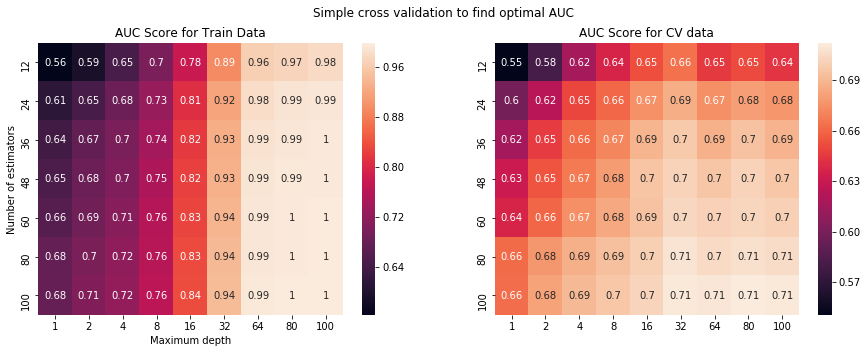

In [78]:
SCV(x1_train,Y_train,x1_cv,Y_cv)

#### Observations
    1. After applying Random forest classifier on BOW model, the model is obtained for different number of estimators and 
       different number of depths.
    2. Here we consider number of estimators and maximum depths as our hyper parameters.   
    3. The model works much better than decision trees.
    4. It can be seen that auc value of train data reaches 1 without overfitting the data 
    5. We can find that with number of estimators as 36 and depth at 32, the model works well for both train and test cv.
       Hence we can consider them as our optimal hyperparameters. 
    6. As depth value increases, We can say that the model tends to overfit, and as the value of minimum sample decreases
       the model tends to underfit
    7. As the data is unbalanced, We used the feature balanced to assign weights for majority and minority class.
    8. We plotted a heat map for different number of estimators and depths

### Testing with Test data

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:08<00:00,  8.24it/s]


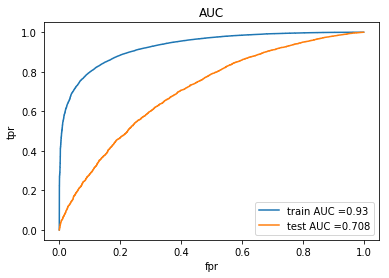

In [80]:
AUC(x1_train,Y_train,x1_test,Y_test,32,36)

#### Observations
    1. We observe that the area under curve or the Roc plot shows that both train and test have an area of nearly
       0.93 and 0.708.
    2. After testing with various values of depth and estimators, such an optimized result has been obtained.
    3. After multiple trials, we find that the AUC is highest for depth=32 and estimators=36.

### Confusion matrix

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:07<00:00,  9.01it/s]


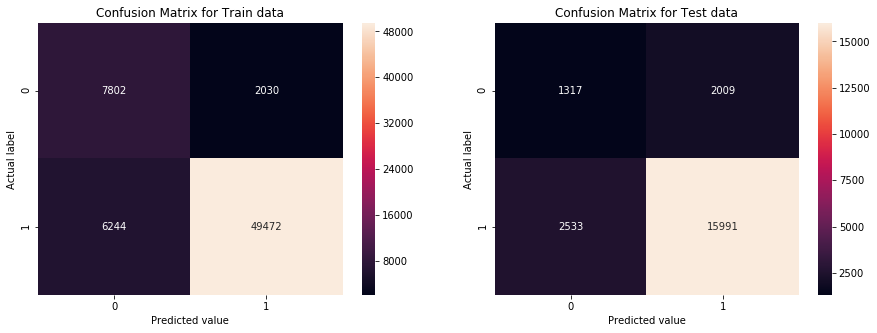

In [195]:
confusion(x1_train,Y_train,x1_test,Y_test,32,36)

##### Definitions
       1.True Postive: A true positive is an outcome where the model correctly predicts the positive class.
       2.True Negative: A true negative is an outcome where the model correctly predicts the negative class.
       3.False positive: A false positive is an outcome where the model incorrectly predicts the positive class.
       4.False negative: A false negative is an outcome where the model incorrectly predicts the negative class.
#### Observations
        1. We find that the best accuracy of our model on test data is 79% 
        2. Here Random forest performs much better than decision trees.
        3. We find that random forests may not work well with one hot encoding. Hence we implemented response coding
        3. The Recall is 0.86 and 0.40 for positive and negative class respectively
        4. The computation time is better than that of KNN

### 2.4.2 Applying RF on TFIDF,<font color='red'> SET 2</font>

In [97]:
#emcoding data using data modelling function
x2_train, x2_test,x2_cv= data_modelling(2,data_train,data_test,data_cv)
print("The shape of training data after encoding: ",x2_train.shape , "Y_train: ", Y_train.shape)
print("The shape of testing data after encoding: ",x2_test.shape , "Y_test: ", Y_test.shape)
print("The shape of cross validation data after encoding: ",x2_cv.shape,"Y_cv: ",Y_cv.shape)

The shape of essay words after applying BOW:  (65548, 10098)
All the features are encoded successfully and TF-IDF is used! 
The shape of training data after encoding:  (65548, 14627) Y_train:  (65548, 1)
The shape of testing data after encoding:  (21850, 14627) Y_test:  (21850, 1)
The shape of cross validation data after encoding:  (21850, 14627) Y_cv:  (21850, 1)


### Simple Cross Validation

100%|███████████████████████████████████████████████████████████████████████████████████| 7/7 [22:54<00:00, 225.37s/it]


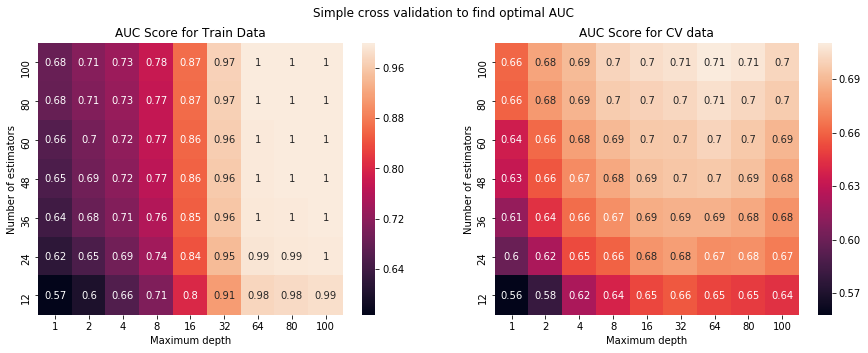

In [98]:
SCV(x2_train,Y_train,x2_cv,Y_cv)

#### Observations
    1. After applying Random forest classifier on TF-IDF model, the model is obtained for different number of estimators and 
       different number of depths.
    2. Here we consider number of estimators and maximum depths as our hyper parameters.   
    3. The model works much better than decision trees.
    4. It can be seen that auc value of train data reaches 1 without overfitting the data 
    5. We can find that with number of estimators as 100 and depth at 32, the model works well for both train and test cv.
       Hence we can consider them as our optimal hyperparameters. 
    6. As depth value increases, We can say that the model tends to overfit, and as the value of minimum sample decreases
       the model tends to underfit
    7. As the data is unbalanced, We used the feature balanced to assign weights for majority and minority class.
    8. We plotted a heat map for different number of estimators and depths

### Testing with Test data

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:22<00:00,  3.34it/s]


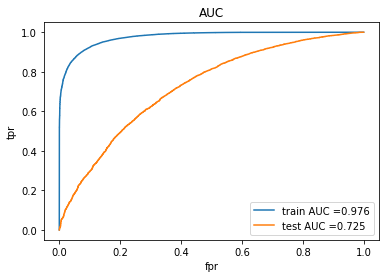

In [101]:
AUC(x2_train,Y_train,x2_test,Y_test,32,100)

#### Observations
    1. We observe that the area under curve or the Roc plot shows that both train and test have an area of nearly
       0.97 and 0.725.
    2. After testing with various values of depth and estimators, such an optimized result has been obtained.
    3. After multiple trials, we find that the AUC is highest for depth=32 and estimators=100.

### Confusion Matrix

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:09<00:00,  8.22it/s]


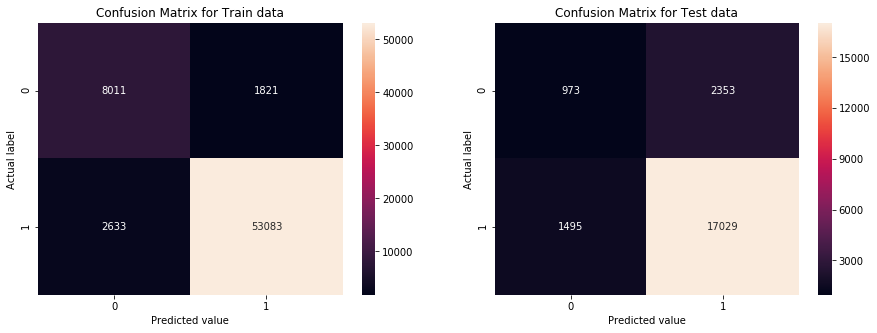

In [196]:
confusion(x2_train,Y_train,x2_test,Y_test,32,100)

##### Definitions
       1.True Postive: A true positive is an outcome where the model correctly predicts the positive class.
       2.True Negative: A true negative is an outcome where the model correctly predicts the negative class.
       3.False positive: A false positive is an outcome where the model incorrectly predicts the positive class.
       4.False negative: A false negative is an outcome where the model incorrectly predicts the negative class.
#### Observations
        1. We find that the best accuracy of our model on test data is 64% 
        2. Here Random forest performs much better than decision trees.
        3. We find that random forests may not work well with one hot encoding. Hence we implemented response coding
        4. The computation time is better than that of KNN

### 2.4.3 Applying RF on AVG W2V,<font color='red'> SET 3</font>

In [125]:
#emcoding data using data modelling function
x3_train, x3_test,x3_cv= data_modelling(3,data_train,data_test,data_cv)
print("The shape of training data after encoding: ",x3_train.shape , "Y_train: ", Y_train.shape)
print("The shape of testing data after encoding: ",x3_test.shape , "Y_test: ", Y_test.shape)
print("The shape of cross validation data after encoding: ",x3_cv.shape,"Y_cv: ",Y_cv.shape)

100%|██████████████████████████████████████████████████████████████████████████| 21850/21850 [00:08<00:00, 2676.74it/s]


All the features are encoded successfully and AVG-W2V is used! 
The shape of training data after encoding:  (65548, 912) Y_train:  (65548, 1)
The shape of testing data after encoding:  (21850, 912) Y_test:  (21850, 1)
The shape of cross validation data after encoding:  (21850, 912) Y_cv:  (21850, 1)


### Simple Cross validation

100%|████████████████████████████████████████████████████████████████████████████████| 7/7 [1:56:38<00:00, 1234.14s/it]


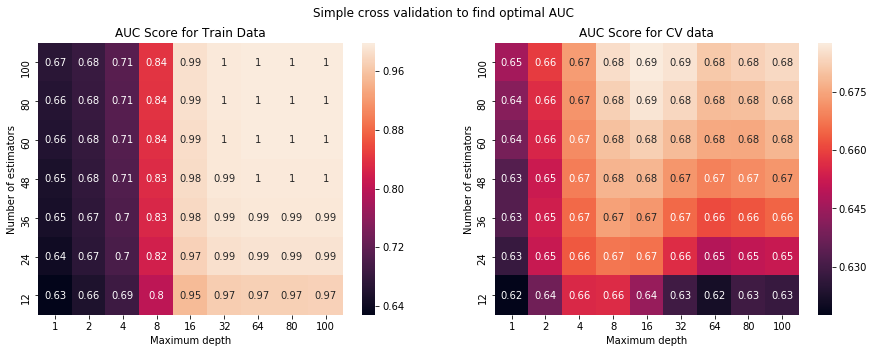

In [126]:
SCV(x3_train,Y_train,x3_cv,Y_cv)

#### Observations
    1. After applying Random forest classifier on AVG-W2V model, the model is obtained for different number of estimators and 
       different number of depths.
    2. Here we consider number of estimators and maximum depths as our hyper parameters.   
    3. The model works much better than decision trees.
    4. It can be seen that auc value of train data reaches 1 without overfitting the data 
    5. We can find that with number of estimators as 48 and depth at 16, the model works well for both train and test cv.
       Hence we can consider them as our optimal hyperparameters. 
    6. As depth value increases, We can say that the model tends to overfit, and as the value of minimum sample decreases
       the model tends to underfit
    7. As the data is unbalanced, We used the feature balanced to assign weights for majority and minority class.
    8. We plotted a heat map for different number of estimators and depths

### Testing with test data

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:10<00:00,  6.88it/s]


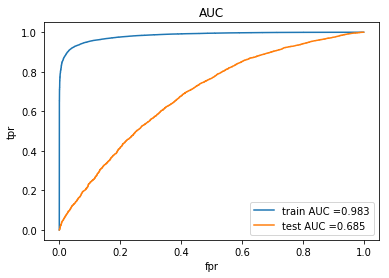

In [136]:
AUC(x3_train,Y_train,x3_test,Y_test,16,48)

#### Observations
    1. We observe that the area under curve or the Roc plot shows that both train and test have an area of nearly
       0.983 and 0.685.
    2. After testing with various values of depth and estimators, such an optimized result has been obtained.
    3. After multiple trials, we find that the AUC is highest for depth=16 and estimators=48.

### Confusion Matrix

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:10<00:00,  6.81it/s]


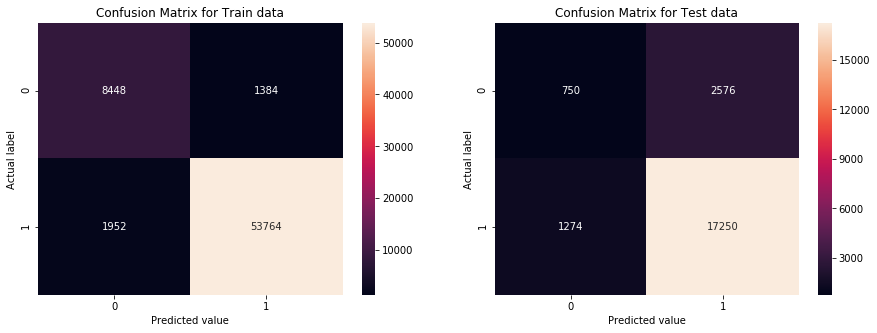

In [197]:
confusion(x3_train,Y_train,x3_test,Y_test,16,48)

##### Definitions
       1.True Postive: A true positive is an outcome where the model correctly predicts the positive class.
       2.True Negative: A true negative is an outcome where the model correctly predicts the negative class.
       3.False positive: A false positive is an outcome where the model incorrectly predicts the positive class.
       4.False negative: A false negative is an outcome where the model incorrectly predicts the negative class.
#### Observations
        1. Here Random forest performs much better than decision trees.
        2. We find that random forests may not work well with one hot encoding. Hence we implemented response coding
        3. The computation time is better than that of KNN

### 2.4.3 Applying RF on TF-IDF W2V,<font color='red'> SET 4</font>

In [127]:
#emcoding data using data modelling function
x4_train, x4_test,x4_cv= data_modelling(4,data_train,data_test,data_cv)
print("The shape of training data after encoding: ",x4_train.shape , "Y_train: ", Y_train.shape)
print("The shape of testing data after encoding: ",x4_test.shape , "Y_test: ", Y_test.shape)
print("The shape of cross validation data after encoding: ",x4_cv.shape,"Y_cv: ",Y_cv.shape)

100%|███████████████████████████████████████████████████████████████████████████| 21850/21850 [01:03<00:00, 342.87it/s]


All the features are encoded successfully and TFIDF-W2V is used! 
The shape of training data after encoding:  (65548, 912) Y_train:  (65548, 1)
The shape of testing data after encoding:  (21850, 912) Y_test:  (21850, 1)
The shape of cross validation data after encoding:  (21850, 912) Y_cv:  (21850, 1)


### Simple Cross Validation

100%|████████████████████████████████████████████████████████████████████████████████| 7/7 [1:51:42<00:00, 1180.26s/it]


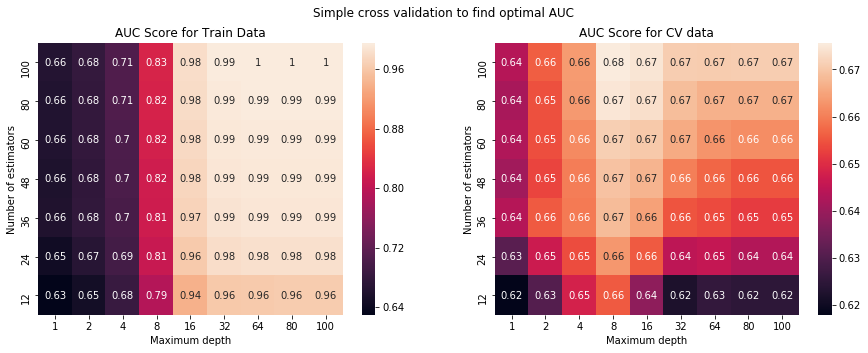

In [135]:
SCV(x4_train,Y_train,x4_cv,Y_cv)

#### Observations
    1. After applying Random forest classifier on TF-IDF model, the model is obtained for different number of estimators and 
       different number of depths.
    2. Here we consider number of estimators and maximum depths as our hyper parameters.   
    3. The model works much better than decision trees.
    4. It can be seen that auc value of train data reaches 1 without overfitting the data 
    5. We can find that with number of estimators as 8 and depth at 100, the model works well for both train and test cv.
       Hence we can consider them as our optimal hyperparameters. 
    6. As depth value increases, We can say that the model tends to overfit, and as the value of minimum sample decreases
       the model tends to underfit
    7. As the data is unbalanced, We used the feature balanced to assign weights for majority and minority class.
    8. We plotted a heat map for different number of estimators and depths

### Testing with Test data

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:12<00:00,  5.17it/s]


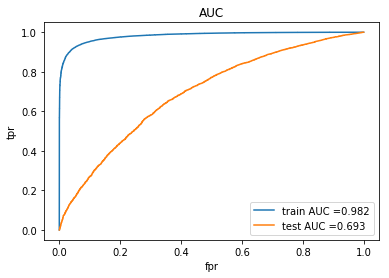

In [139]:
AUC(x4_train,Y_train,x4_test,Y_test,16,100)

#### Observations
    1. We observe that the area under curve or the Roc plot shows that both train and test have an area of nearly
       0.982 and 0.693.
    2. After testing with various values of depth and estimators, such an optimized result has been obtained.
    3. After multiple trials, we find that the AUC is highest for depth=16 and estimators=100.

### Confusion Matrix

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:10<00:00,  6.77it/s]


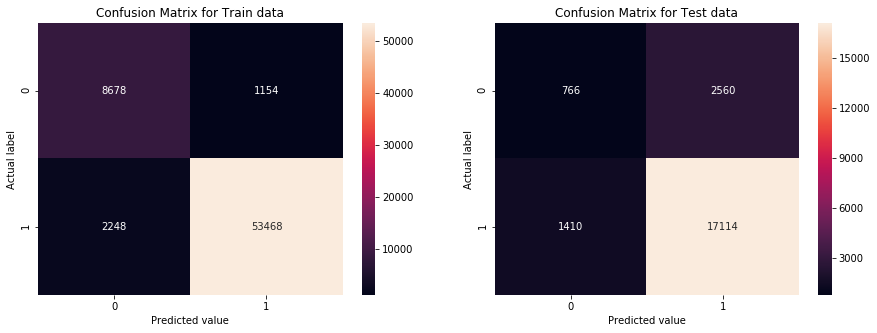

In [198]:
confusion(x4_train,Y_train,x4_test,Y_test,16,100)

##### Definitions
       1.True Postive: A true positive is an outcome where the model correctly predicts the positive class.
       2.True Negative: A true negative is an outcome where the model correctly predicts the negative class.
       3.False positive: A false positive is an outcome where the model incorrectly predicts the positive class.
       4.False negative: A false negative is an outcome where the model incorrectly predicts the negative class.
#### Observations
        1. Here Random forest performs much better than decision trees.
        2. We find that random forests may not work well with one hot encoding. Hence we implemented response coding
        3. The computation time is better than that of KNN


<h2>2.5 Applying GBDT</h2>

<br>Apply GBDT on different kind of featurization as mentioned in the instructions
<br> For Every model that you work on make sure you do the step 2 and step 3 of instrucations

In [180]:
def SCV(x,y,x1,y1): #function for simple cross validation and calculation of auc for different alphas   
    from sklearn.metrics import roc_curve, auc
    from sklearn.linear_model import SGDClassifier
    from sklearn.metrics import roc_auc_score
    from matplotlib import pylab
    from tqdm import tqdm
    from sklearn.ensemble import RandomForestClassifier
    import xgboost as xgb
    #from sklearn.calibration import CalibratedClassifierCV 
    import math
    import numpy as np
    #x11_train=x
    #y11_train= y
    train = []
    cv = []

    #k1 = np.arange(0,2,0.0001)
    n_estimator= [12, 24, 36, 48,60]
    max_depths=[1,2,4,8,16,32]
    #k3=[]
    #for k in max_depths:
    #    k3.append(math.log(k))
    #for j in min_samples:
    #    k2.append(math.log(j))
    #    k3.append([math.log(j),j])
    #print(k3)    
    for i in tqdm(n_estimator):
        train_auc=[]
        cv_auc=[]
        for j in max_depths:
            neigh=xgb.XGBClassifier(max_depth=j, learning_rate=0.1, n_estimators=i, silent=True, objective='binary:logistic', booster='gbtree', n_jobs=-1,scale_pos_weight=0.17, random_state=0)
            neigh.fit(x, y, verbose=False)
            #calibrator = CalibratedClassifierCV(neigh, cv='prefit')
            #calibrator.fit(x11_train,y11_train )
            # roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
            # not the predicted outputs
            predicted_labels = []
            for j in range(0, 65548, 1000):
                predicted_labels.extend(neigh.predict_proba(x[j:j+1000])[:,1])

            #print(len(predicted_labels))
            predicted_labelss = []
            for k in range(0, 21850, 1000):
                predicted_labelss.extend(neigh.predict_proba(x1[k:k+1000])[:,1])

            #y_train_pred =  neigh.predict_proba(x1_train)[:,1]
            #y_cv_pred =  neigh.predict_proba(x1_cv)[:,1]
            #print(len(predicted_labelss))

            train_auc.append(roc_auc_score(y,predicted_labels))
            cv_auc.append(roc_auc_score(y1, predicted_labelss))
         
        train.append([train_auc])
        cv.append([cv_auc])
    import numpy as np
    import pandas as pd
    train= np.array(train)
    cv= np.array(cv)
    train1= train.reshape(len(n_estimator), len(max_depths))
    #print(train1.shape)
    cv1= cv.reshape(len(n_estimator), len(max_depths))
    train2= pd.DataFrame(train1, index=n_estimator, columns= max_depths)
    train2=train2.reindex(index=train2.index[::-1])
    cv2= pd.DataFrame(cv1, index=n_estimator, columns= max_depths)
    cv2=cv2.reindex(index=cv2.index[::-1])
    #print(cv1.shape)
    plt.figure(figsize=(15,5))
    plt.subplot(1,2,1)
    sns.heatmap(train2, annot= True)
    plt.xlabel("Maximum depth")
    plt.ylabel("Number of estimators")
    plt.title("AUC Score for Train Data")
    #plt.yticks(np.arange(len(n_estimator)), n_estimator)
    #plt.xticks(np.arange(len(max_depths)), max_depths)
    plt.subplot(1,2,2)
    #plt.yticks(np.arange(len(n_estimator)), n_estimator)
    #plt.xticks(np.arange(len(n_estimator)), max_depths)
    sns.heatmap(cv2, annot= True)
    plt.xlabel("Maximum depth")
    plt.ylabel("Number of estimators")
    plt.title("AUC Score for CV data")
    plt.suptitle("Simple cross validation to find optimal AUC")
    plt.show()

In [181]:
def AUC(x,y,x1,y1,z,c): #function for testing data
    from sklearn.metrics import roc_curve, auc
    from sklearn.metrics import roc_auc_score
    from sklearn.ensemble import RandomForestClassifier
    import xgboost as xgb
    #from sklearn.calibration import CalibratedClassifierCV
    #x11_train=x
    #y11_train= y
    neigh=xgb.XGBClassifier(max_depth=z, learning_rate=0.1, n_estimators=c, silent=True, objective='binary:logistic', booster='gbtree', n_jobs=-1,scale_pos_weight=0.17, random_state=0)
    neigh.fit(x, y, verbose=False)
    # roc_auc_score(y_true, y_score) the 2nd parameter should be probability estimates of the positive class
    # not the predicted outputs
    predicted_labels=[]
    predicted_labelss=[]
    for j in tqdm(range(0, 65548, 1000)):
        predicted_labels.extend(neigh.predict_proba(x[j:j+1000])[:,1])
    for m in range(0, 21850, 1000):
        predicted_labelss.extend(neigh.predict_proba(x1[m:m+1000])[:,1])    


    train_fpr, train_tpr, threshold = roc_curve(y, predicted_labels)
    test_fpr, test_tpr, thresholds = roc_curve(y1, predicted_labelss)
    #print(train_fpr[0:150])
    #print(threshold[0:150])
    plt.plot(train_fpr, train_tpr, label="train AUC ="+str(np.round(auc(train_fpr, train_tpr),3)))
    plt.plot(test_fpr, test_tpr, label="test AUC ="+str(np.round(auc(test_fpr, test_tpr),3)))
    plt.legend()
    plt.xlabel("fpr")
    plt.ylabel("tpr")
    plt.title("AUC")
    plt.show()

    

    #from sklearn.metrics import confusion_matrix
    #print("Train confusion matrix")
    #print(confusion_matrix(y_train, neigh.predict(X_train_bow)))
    #print("Test confusion matrix")
    #print(confusion_matrix(y_test, neigh.predict(X_test_bow)))

In [199]:
def confusion(x1,y1,x2,y2,z,c): #function for plotting confusion matrix
    from sklearn.metrics import confusion_matrix#https://seaborn.pydata.org/generated/seaborn.heatmap.html
    import seaborn as sns
    import xgboost as xgb
    from sklearn.metrics import roc_curve, auc
    from sklearn.neighbors import KNeighborsClassifier
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.calibration import CalibratedClassifierCV
    from sklearn.metrics import roc_auc_score
    from sklearn.tree import export_graphviz
    from sklearn import tree
    x11_train= x1
    y11_train= y1
    #y11=y1.map({0.0:"negative", 1.0:"positive"})
    neigh=xgb.XGBClassifier(max_depth=z, learning_rate=0.1, n_estimators=c, silent=True, objective='binary:logistic', booster='gbtree', n_jobs=-1,scale_pos_weight=0.17, random_state=0)
    neigh.fit(x1, y1,verbose=False)
    

    predicted_labels=[]
    predicted_labelss=[]
    for j in tqdm(range(0, 65548, 1000)):
        predicted_labels.extend(neigh.predict(x1[j:j+1000]))
    for m in range(0, 21850, 1000):
        predicted_labelss.extend(neigh.predict(x2[m:m+1000]))    
    
    
    from sklearn.utils.class_weight import compute_sample_weight
    weights=compute_sample_weight(class_weight='balanced', y=y1)
    
    confusion= confusion_matrix(y1, predicted_labels)
    weights1=compute_sample_weight(class_weight='balanced', y=y2)
    confusion_test= confusion_matrix(y2, predicted_labelss)
    label= ["0","1"]
    confusion_pd = pd.DataFrame(confusion.astype(int), index= label, columns= label)
    confusion_test_pd= pd.DataFrame(confusion_test.astype(int), index= label, columns= label)

    plt.figure(figsize=(15,5))
    plt.subplot(1,2,1)
    sns.heatmap(confusion_pd, annot= True, fmt="d")
    plt.xlabel("Predicted value")
    plt.ylabel("Actual label")
    plt.title("Confusion Matrix for Train data")
    plt.subplot(1,2,2)
    sns.heatmap(confusion_test_pd, annot= True, fmt= "d")
    plt.xlabel("Predicted value")
    plt.ylabel("Actual label")
    plt.title("Confusion Matrix for Test data")
    plt.show()    


### 2.5.1 Applying XGBOOST on BOW,<font color='red'> SET 1</font>

### Simple cross validation

100%|████████████████████████████████████████████████████████████████████████████████| 7/7 [2:35:15<00:00, 1681.87s/it]


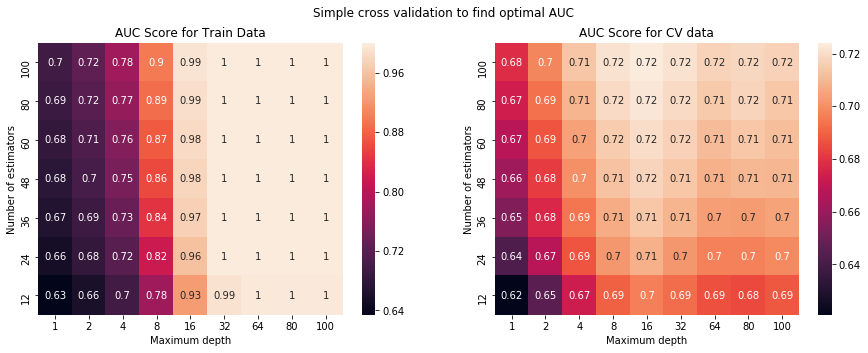

In [161]:
SCV(x1_train,Y_train,x1_cv,Y_cv)

#### Observations
    1. After applying XGboost classifier on BOW model, the model is obtained for different number of estimators and 
       different number of depths.
    2. Here we consider number of estimators and maximum depths as our hyper parameters.   
    3. The model works much better than previous models we worked on.
    4. It can be seen that auc value of train data reaches 1 without overfitting the data 
    5. We can find that with number of estimators as 16 and depth at 48, the model works well for both train and test cv.
       Hence we can consider them as our optimal hyperparameters. 
    6. As depth value increases, We can say that the model tends to overfit, and as the value of minimum sample decreases
       the model tends to underfit
    7. As the data is unbalanced, We used the feature balanced to assign weights for majority and minority class.
    8. We plotted a heat map for different number of estimators and depths
    9. computation time is a bit high

### Testing with Test data

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:07<00:00,  8.85it/s]


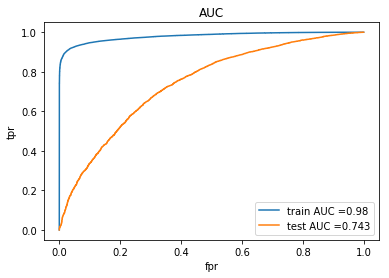

In [184]:
AUC(x1_train,Y_train,x1_test,Y_test,16,48)

#### Observations
    1. We observe that the area under curve or the Roc plot shows that both train and test have an area of nearly
       0.98 and 0.743.
    2. After testing with various values of depth and estimators, such an optimized result has been obtained.
    3. After multiple trials, we find that the AUC is highest for depth=16 and estimators=48.

### Confusion Matrix

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:07<00:00,  8.26it/s]


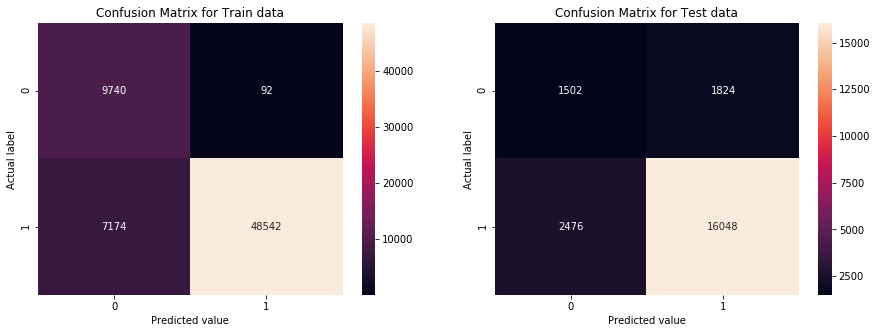

In [200]:
confusion(x1_train,Y_train,x1_test,Y_test,16,48)

##### Definitions
       1.True Postive: A true positive is an outcome where the model correctly predicts the positive class.
       2.True Negative: A true negative is an outcome where the model correctly predicts the negative class.
       3.False positive: A false positive is an outcome where the model incorrectly predicts the positive class.
       4.False negative: A false negative is an outcome where the model incorrectly predicts the negative class.
#### Observations
        1. The accuracy is 80.3%
        2. Here XGboost performs much better than decision trees.
        3. We find that random forests may not work well with one hot encoding. Hence we implemented response coding
        4. The computation time is a bit higher than that of random forest classifier

### 2.5.2 Applying XGBOOST on TF-IDF,<font color='red'> SET 2</font>

### Simple Cross Validation

100%|███████████████████████████████████████████████████████████████████████████████████| 5/5 [55:49<00:00, 714.55s/it]


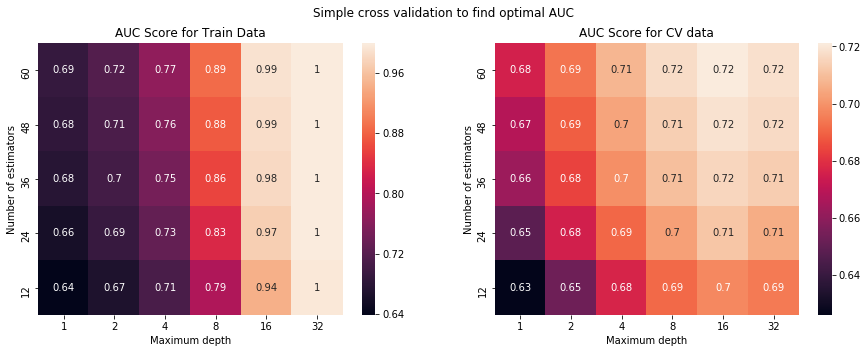

In [166]:
SCV(x2_train,Y_train,x2_cv,Y_cv)

#### Observations
    1. After applying XGboost classifier on TF-IDF model, the model is obtained for different number of estimators and 
       different number of depths.
    2. Here we consider number of estimators and maximum depths as our hyper parameters.   
    3. The model works much better than previous models we worked on.
    4. It can be seen that auc value of train data reaches 1 without overfitting the data 
    5. We can find that with number of estimators as 16 and depth at 36, the model works well for both train and test cv.
       Hence we can consider them as our optimal hyperparameters. 
    6. As depth value increases, We can say that the model tends to overfit, and as the value of minimum sample decreases
       the model tends to underfit
    7. As the data is unbalanced, We used the feature balanced to assign weights for majority and minority class.
    8. We plotted a heat map for different number of estimators and depths
    9. computation time is a bit high

### Testing with test data

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:07<00:00,  9.45it/s]


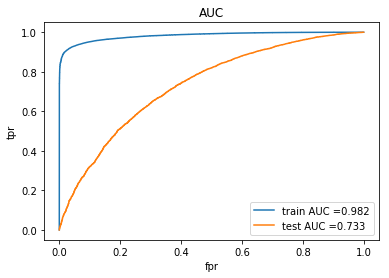

In [185]:
AUC(x2_train,Y_train,x2_test,Y_test,16,36)

#### Observations
    1. We observe that the area under curve or the Roc plot shows that both train and test have an area of nearly
       0.982 and 0.733.
    2. After testing with various values of depth and estimators, such an optimized result has been obtained.
    3. After multiple trials, we find that the AUC is highest for depth=16 and estimators=36.

### Confusion Matrix

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:08<00:00,  7.95it/s]


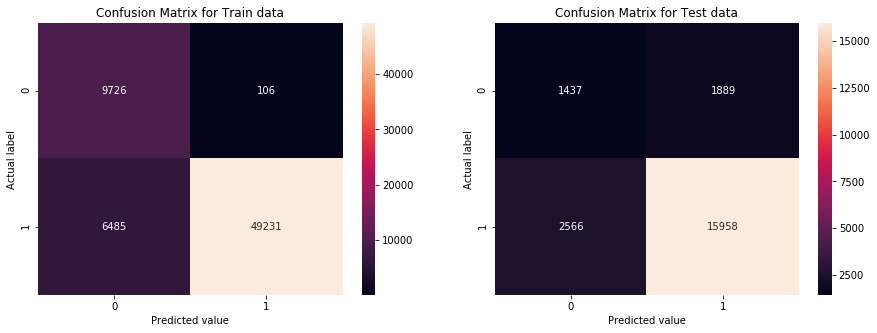

In [201]:
confusion(x2_train,Y_train,x2_test,Y_test,16,36)

##### Definitions
       1.True Postive: A true positive is an outcome where the model correctly predicts the positive class.
       2.True Negative: A true negative is an outcome where the model correctly predicts the negative class.
       3.False positive: A false positive is an outcome where the model incorrectly predicts the positive class.
       4.False negative: A false negative is an outcome where the model incorrectly predicts the negative class.
#### Observations
        1. The accuracy is 81%
        2. Here XGboost performs much better than decision trees.
        3. We find that random forests may not work well with one hot encoding. Hence we implemented response coding
        4. The computation time is a bit higher than that of random forest classifier

### 2.5.3 Applying XGBOOST on AVG-W2V,<font color='red'> SET 3</font>

### Simple Cross Validation

100%|████████████████████████████████████████████████████████████████████████████████| 5/5 [4:08:27<00:00, 3193.83s/it]


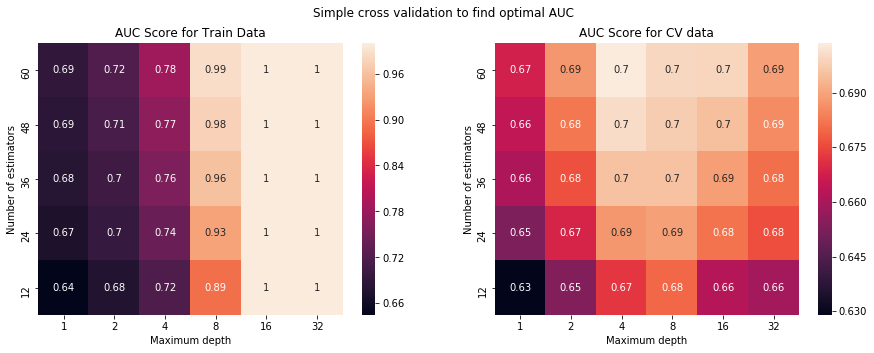

In [167]:
SCV(x3_train,Y_train,x3_cv,Y_cv)

#### Observations
    1. After applying XGboost classifier on AVG-W2V model, the model is obtained for different number of estimators and 
       different number of depths.
    2. Here we consider number of estimators and maximum depths as our hyper parameters.   
    3. The model works much better than previous models we worked on.
    4. It can be seen that auc value of train data reaches 1 without overfitting the data 
    5. We can find that with number of estimators as 8 and depth at 36, the model works well for both train and test cv.
       Hence we can consider them as our optimal hyperparameters. 
    6. As depth value increases, We can say that the model tends to overfit, and as the value of minimum sample decreases
       the model tends to underfit
    7. As the data is unbalanced, We used the feature balanced to assign weights for majority and minority class.
    8. We plotted a heat map for different number of estimators and depths
    9. computation time is a bit high

### Testing with Test data

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:26<00:00,  2.99it/s]


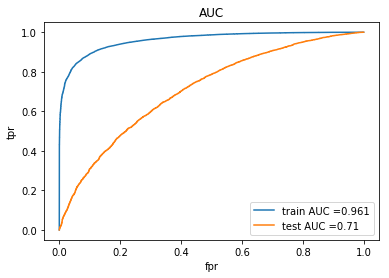

In [187]:
AUC(x3_train,Y_train,x3_test,Y_test,8,36)

#### Observations
    1. We observe that the area under curve or the Roc plot shows that both train and test have an area of nearly
       0.961 and 0.71.
    2. After testing with various values of depth and estimators, such an optimized result has been obtained.
    3. After multiple trials, we find that the AUC is highest for depth=8 and estimators=36.

### Confusion Matrix

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:32<00:00,  3.01it/s]


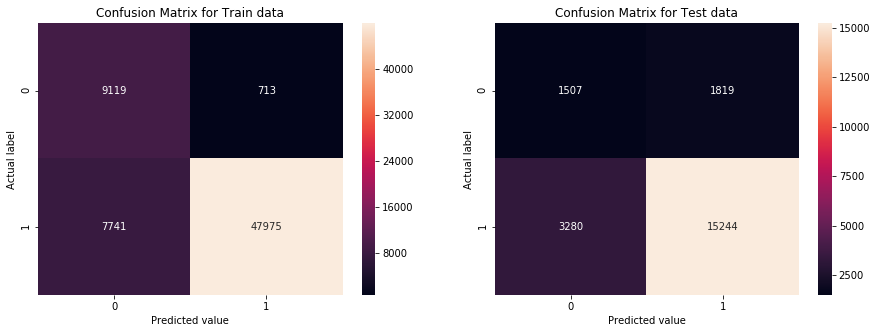

In [202]:
confusion(x3_train,Y_train,x3_test,Y_test,8,36)

##### Definitions
       1.True Postive: A true positive is an outcome where the model correctly predicts the positive class.
       2.True Negative: A true negative is an outcome where the model correctly predicts the negative class.
       3.False positive: A false positive is an outcome where the model incorrectly predicts the positive class.
       4.False negative: A false negative is an outcome where the model incorrectly predicts the negative class.
#### Observations
        1. The accuracy is 76%
        2. Here XGboost performs much better than decision trees.
        3. We find that random forests may not work well with one hot encoding. Hence we implemented response coding
        4. The computation time is a bit higher than that of random forest classifier

### 2.5.4 Applying XGBOOST on TFIDF-W2V,<font color='red'> SET 4</font>

### Simple cross validation

100%|████████████████████████████████████████████████████████████████████████████████| 5/5 [4:48:30<00:00, 3693.06s/it]


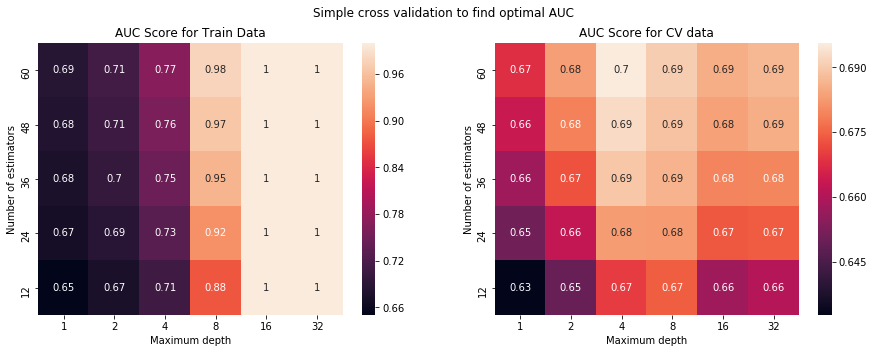

In [168]:
SCV(x4_train,Y_train,x4_cv,Y_cv)

#### Observations
    1. After applying XGboost classifier on TFIDF-W2V model, the model is obtained for different number of estimators and 
       different number of depths.
    2. Here we consider number of estimators and maximum depths as our hyper parameters.   
    3. The model works much better than previous models we worked on.
    4. It can be seen that auc value of train data reaches 1 without overfitting the data 
    5. We can find that with number of estimators as 8 and depth at 36, the model works well for both train and test cv.
       Hence we can consider them as our optimal hyperparameters. 
    6. As depth value increases, We can say that the model tends to overfit, and as the value of minimum sample decreases
       the model tends to underfit
    7. As the data is unbalanced, We used the feature balanced to assign weights for majority and minority class.
    8. We plotted a heat map for different number of estimators and depths
    9. computation time is a bit high

### Testing with test data

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:24<00:00,  3.09it/s]


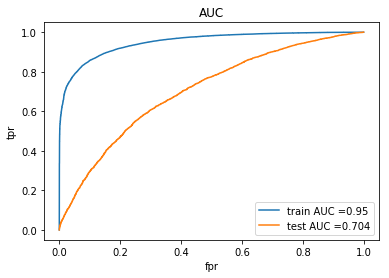

In [188]:
AUC(x4_train,Y_train,x4_test,Y_test,8,36)

#### Observations
    1. We observe that the area under curve or the Roc plot shows that both train and test have an area of nearly
       0.95 and 0.704.
    2. After testing with various values of depth and estimators, such an optimized result has been obtained.
    3. After multiple trials, we find that the AUC is highest for depth=8 and estimators=36.

### Confusion Matrix

100%|██████████████████████████████████████████████████████████████████████████████████| 66/66 [00:31<00:00,  2.78it/s]


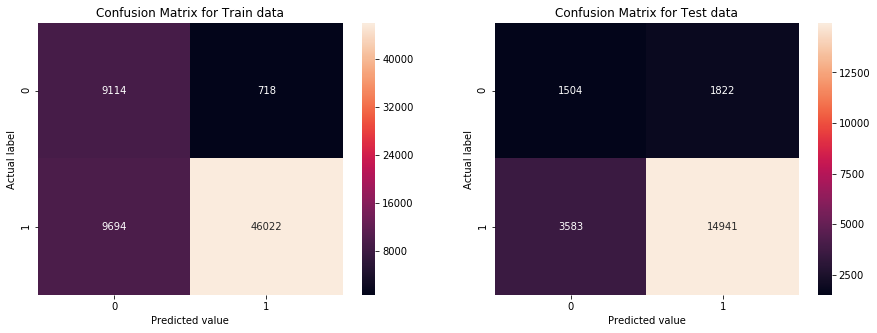

In [203]:
confusion(x4_train,Y_train,x4_test,Y_test,8,36)

##### Definitions
       1.True Postive: A true positive is an outcome where the model correctly predicts the positive class.
       2.True Negative: A true negative is an outcome where the model correctly predicts the negative class.
       3.False positive: A false positive is an outcome where the model incorrectly predicts the positive class.
       4.False negative: A false negative is an outcome where the model incorrectly predicts the negative class.
#### Observations
        1. The accuracy is 73.2%
        2. Here XGboost performs much better than decision trees.
        3. We find that random forests may not work well with one hot encoding. Hence we implemented response coding
        4. The computation time is a bit higher than that of random forest classifier

<h1>3. Conclusions</h1>

In [193]:
from prettytable import PrettyTable
#http://zetcode.com/python/prettytable/
    
x = PrettyTable()

x.field_names = ["Vectorizer", "Model","Maximum Depth", "Number of estimators", "AUC for TEST"]

x.add_row(["BOW", "Random Forest",36,36,0.708])
x.add_row(["BOW", "XGBoost",16,48,0.743])
x.add_row(["TF-IDF", "Random Forest",32,100,0.725])
x.add_row(["TF-IDF", "XGBoost",16,36,0.733])
x.add_row(["AVG-W2v", "Random Forest",16,48,0.685])
x.add_row(["AVG-W2v", "XGBoost",8,36,0.711])
x.add_row(["TFIDF-W2V", "Random Forest",16,100,0.694])
x.add_row(["TFIDF-W2V", "XGBoost",8,36,0.704])


print(x)

+------------+---------------+---------------+----------------------+--------------+
| Vectorizer |     Model     | Maximum Depth | Number of estimators | AUC for TEST |
+------------+---------------+---------------+----------------------+--------------+
|    BOW     | Random Forest |       36      |          36          |    0.708     |
|    BOW     |    XGBoost    |       16      |          48          |    0.743     |
|   TF-IDF   | Random Forest |       32      |         100          |    0.725     |
|   TF-IDF   |    XGBoost    |       16      |          36          |    0.733     |
|  AVG-W2v   | Random Forest |       16      |          48          |    0.685     |
|  AVG-W2v   |    XGBoost    |       8       |          36          |    0.711     |
| TFIDF-W2V  | Random Forest |       16      |         100          |    0.694     |
| TFIDF-W2V  |    XGBoost    |       8       |          36          |    0.704     |
+------------+---------------+---------------+-------------------

### Final Observations
    1. We've trained our data set with BOW,TF-IDF, AVG-W2V, TFIDF- W2V and word-column frequency and tested it to 
       precict whether a given project would be accepted or not.
    2. As we couldn't find any concrete paramaters for the approval/rejection of projects in EDA, it is likely that our
       our models couldn't be highly efficient(>90%) with given techniques either.
    3. The computation time significantly high for xgboost than random forest.
    4. We've incorporated every possible feature into the data to train the model efficiently in order to obtain good 
       results.
    5. We used response coding for both random forest and decision tree.
    6. Here we have 2 hyperparameters to consider: Maximum depth and Number of estimators.
    7. As Depth increases, the model overfits and as Depth decreases, the model underfits.
    8. It can observed that decision trees work well with smaller depths and generalization is decent
    9. Our model may works well for response coding.